In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.cluster import KMeans, AffinityPropagation, AgglomerativeClustering, Birch, MiniBatchKMeans, OPTICS, DBSCAN
from sklearn.mixture import GaussianMixture
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
from sklearn.model_selection import GridSearchCV
import umap
import plotly.express as px

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# Importing data
spot_df = pd.read_csv('data/spotify_playlist.csv')

In [3]:
# Checking first 5 rows
spot_df.head()

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.325,0.720,122.494,249293,4
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.324,0.267,150.354,308560,4
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.119,0.172,64.223,179200,4
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.258,0.473,81.308,122067,4
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.394,0.781,122.875,224307,4


# Data Understanding

In [4]:
# Checking infomation such as counts and dtypes
spot_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6514 entries, 0 to 6513
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   artist            6513 non-null   object 
 1   artist_id         6514 non-null   object 
 2   popularity        6514 non-null   int64  
 3   album             6513 non-null   object 
 4   track_name        6513 non-null   object 
 5   track_id          6514 non-null   object 
 6   danceability      6514 non-null   float64
 7   energy            6514 non-null   float64
 8   key               6514 non-null   int64  
 9   loudness          6514 non-null   float64
 10  mode              6514 non-null   int64  
 11  speechiness       6514 non-null   float64
 12  instrumentalness  6514 non-null   float64
 13  liveness          6514 non-null   float64
 14  valence           6514 non-null   float64
 15  tempo             6514 non-null   float64
 16  duration_ms       6514 non-null   int64  


In [5]:
#Checking aggregate data
spot_df.describe()

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
count,6514.000000,6514.000000,6514.000000,6514.000000,6514.000000,6514.000000,6514.000000,6514.000000,6514.000000,6514.000000,6514.000000,6.514000e+03,6514.000000
mean,38.185293,0.505411,0.718306,5.152748,-7.549406,0.672398,0.078551,0.138753,0.207243,0.502779,125.020099,2.247691e+05,3.934602
std,25.599819,0.164042,0.245218,3.565083,4.278693,0.469375,0.070419,0.287835,0.163056,0.243474,30.364398,7.749594e+04,0.321725
min,0.000000,0.072200,0.000685,0.000000,-41.932000,0.000000,0.022500,0.000000,0.009670,0.028600,36.172000,2.845500e+04,1.000000
25%,13.000000,0.391000,0.581000,2.000000,-9.526750,0.000000,0.037400,0.000000,0.096000,0.313000,100.621250,1.782718e+05,4.000000
50%,42.000000,0.503000,0.795000,5.000000,-6.363500,1.000000,0.052000,0.000124,0.143000,0.497000,122.998500,2.157000e+05,4.000000
75%,59.000000,0.619000,0.917000,8.000000,-4.615250,1.000000,0.088775,0.048575,0.290000,0.694000,144.746000,2.579930e+05,4.000000
max,89.000000,0.979000,0.999000,11.000000,-0.140000,1.000000,0.948000,0.994000,0.981000,0.995000,214.419000,1.050827e+06,5.000000


In [6]:
#Checking shape
spot_df.shape

(6514, 18)

In [7]:
#Checking for any missing data
spot_df.isna().sum()

artist              1
artist_id           0
popularity          0
album               1
track_name          1
track_id            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
instrumentalness    0
liveness            0
valence             0
tempo               0
duration_ms         0
time_signature      0
dtype: int64

In [8]:
#Checking what row specifically is missing
spot_df[spot_df.isna().any(axis=1)]

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
4400,NaN,0LyfQWJT6nXafLPZqxe9Of,0,NaN,NaN,0lMrWcrVXHPEuVBuc0nRzZ,0.804,0.758,4,-4.819,1,0.0483,0.331,0.125,0.424,127.946,230635,4


In [9]:
#Dropping row with missing value
spot_df.dropna(inplace=True)

In [10]:
#Checking if dropping was successful
spot_df.isna().sum()

artist              0
artist_id           0
popularity          0
album               0
track_name          0
track_id            0
danceability        0
energy              0
key                 0
loudness            0
mode                0
speechiness         0
instrumentalness    0
liveness            0
valence             0
tempo               0
duration_ms         0
time_signature      0
dtype: int64

In [11]:
#Checking infomation after drop
spot_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 6513 entries, 0 to 6513
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   artist            6513 non-null   object 
 1   artist_id         6513 non-null   object 
 2   popularity        6513 non-null   int64  
 3   album             6513 non-null   object 
 4   track_name        6513 non-null   object 
 5   track_id          6513 non-null   object 
 6   danceability      6513 non-null   float64
 7   energy            6513 non-null   float64
 8   key               6513 non-null   int64  
 9   loudness          6513 non-null   float64
 10  mode              6513 non-null   int64  
 11  speechiness       6513 non-null   float64
 12  instrumentalness  6513 non-null   float64
 13  liveness          6513 non-null   float64
 14  valence           6513 non-null   float64
 15  tempo             6513 non-null   float64
 16  duration_ms       6513 non-null   int64  


In [12]:
#Checking numerical features
num_features = spot_df.select_dtypes(exclude=['object'])

In [13]:
#Removing mode and time signature as the information is not as important to the song information
num_features.drop(['time_signature', 'mode'], axis=1, inplace=True)

In [14]:
#checking info after drop
num_features

,popularity,danceability,energy,key,loudness,speechiness,instrumentalness,liveness,valence,tempo,duration_ms
0,8,0.534,0.887,0,-3.777,0.0345,0.000099,0.3250,0.720,122.494,249293
1,0,0.257,0.819,7,-3.562,0.0422,0.015000,0.3240,0.267,150.354,308560
2,64,0.268,0.459,7,-6.948,0.0346,0.000000,0.1190,0.172,64.223,179200
3,69,0.693,0.497,2,-7.316,0.1190,0.000000,0.2580,0.473,81.308,122067
4,0,0.556,0.945,0,-4.347,0.0496,0.000004,0.3940,0.781,122.875,224307
...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0.2750,0.000004,0.3290,0.695,98.104,336917
6510,42,0.852,0.705,2,-10.981,0.0582,0.000002,0.1260,0.833,104.556,246040
6511,70,0.665,0.910,6,-4.682,0.2230,0.000000,0.2270,0.887,84.099,293973
6512,66,0.634,0.845,11,-5.058,0.3520,0.000005,0.0598,0.929,94.000,237027


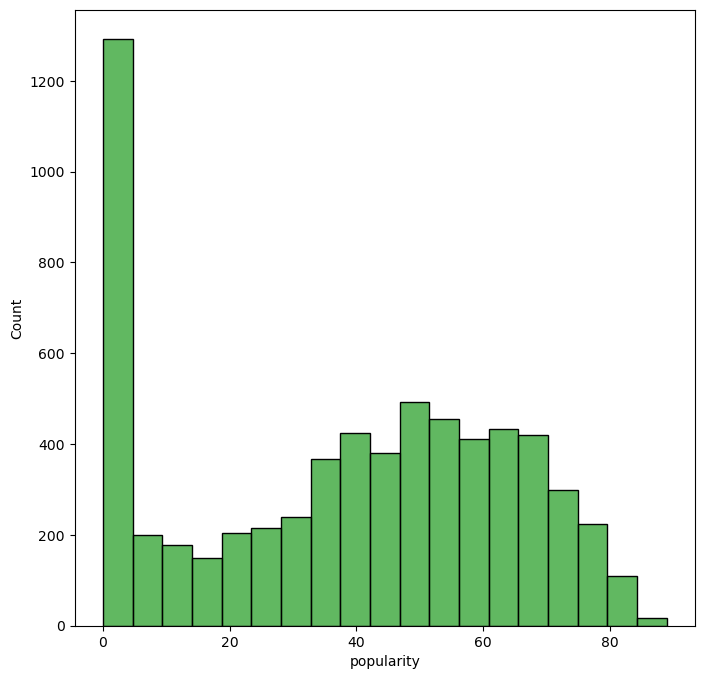

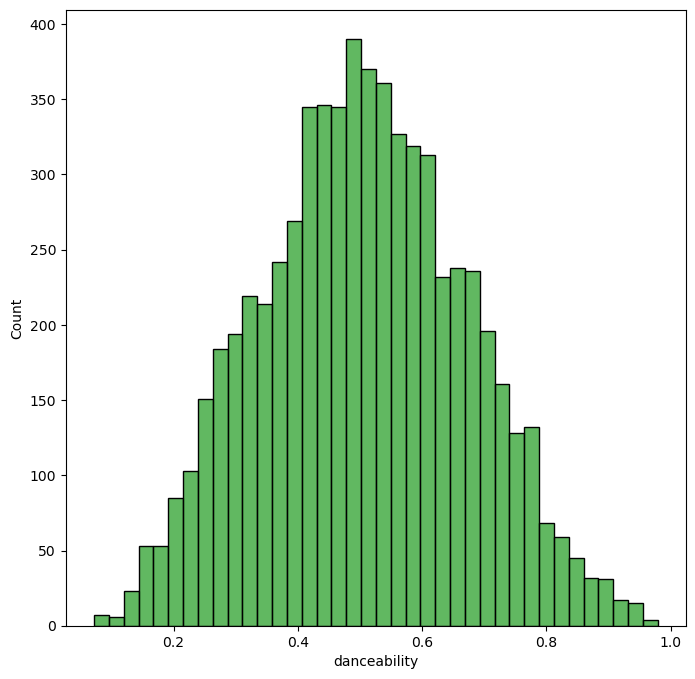

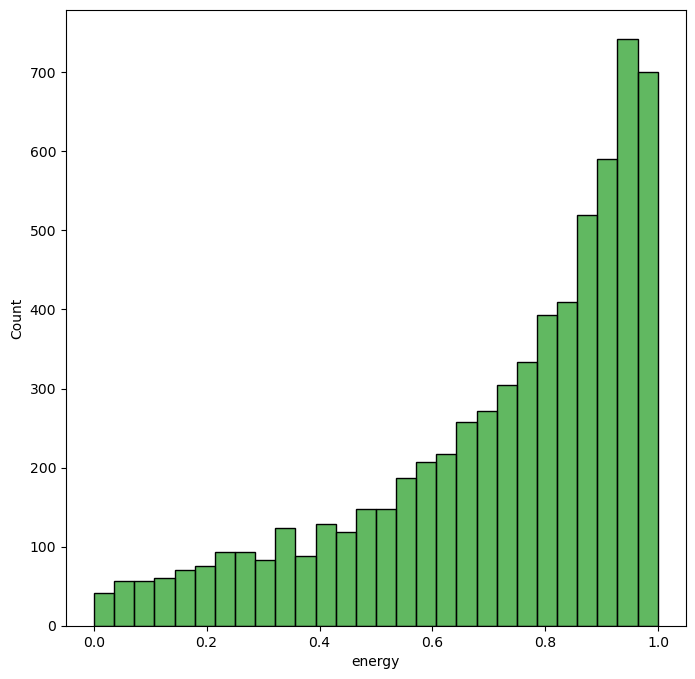

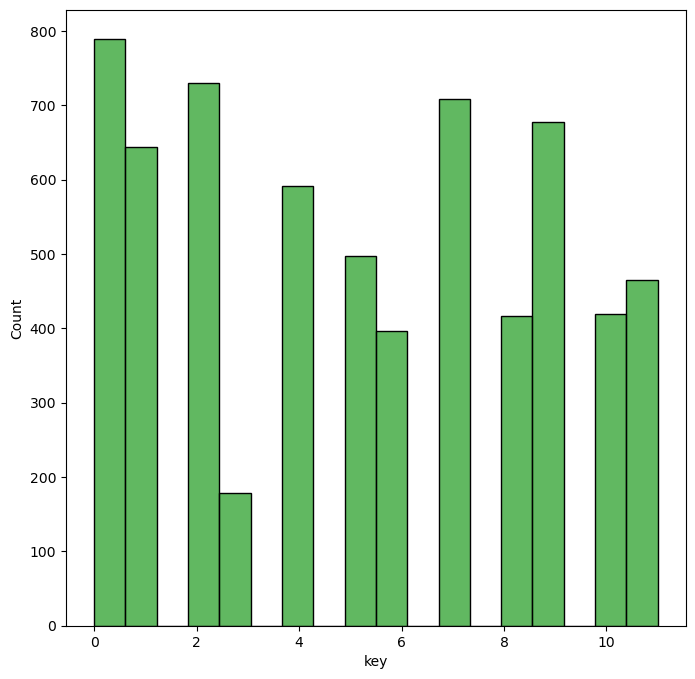

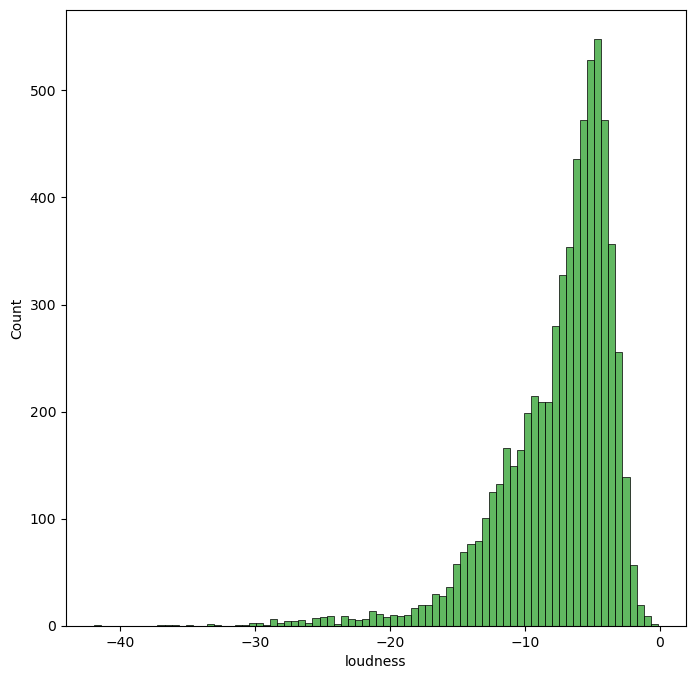

...

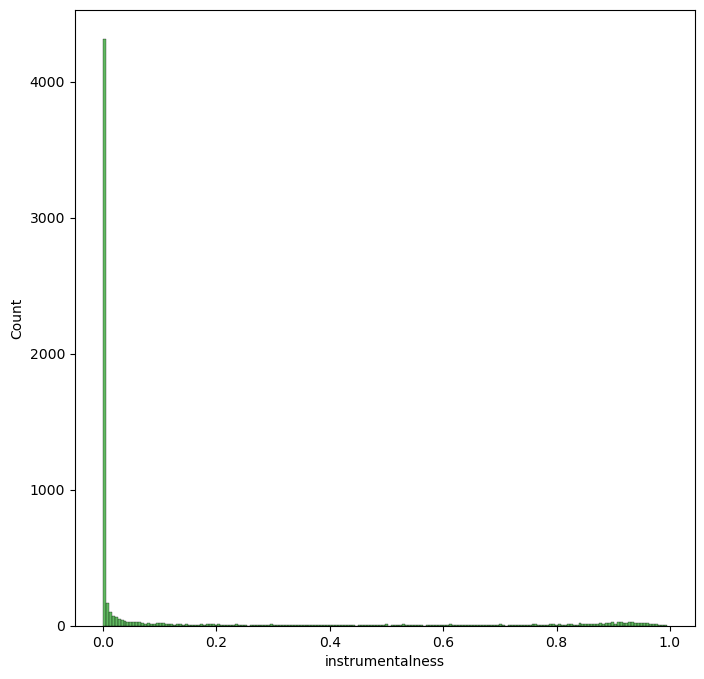

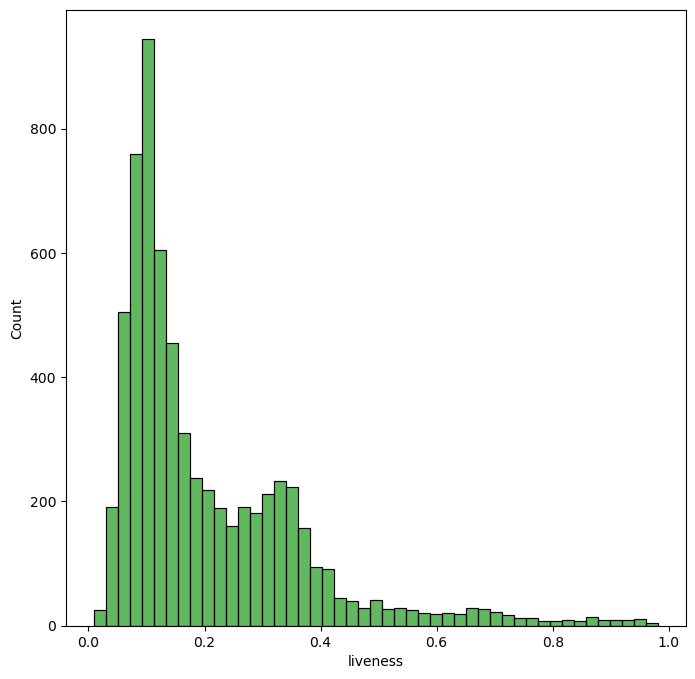

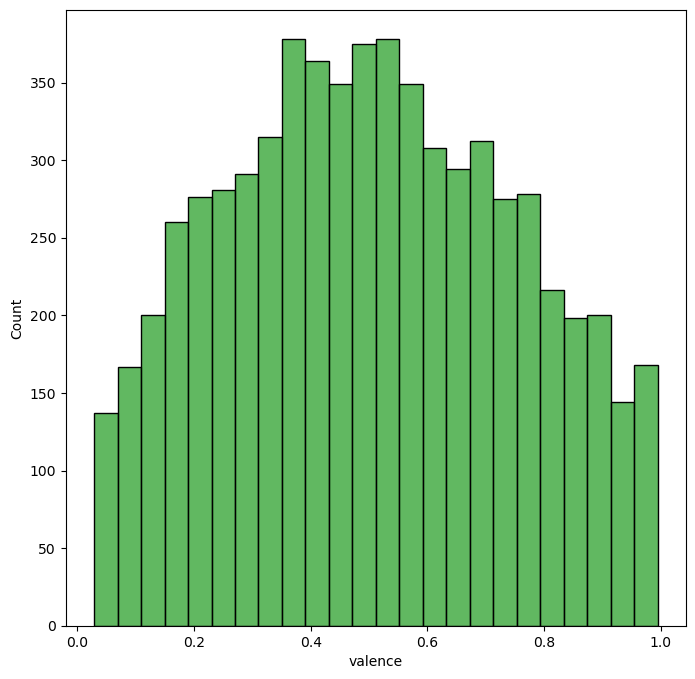

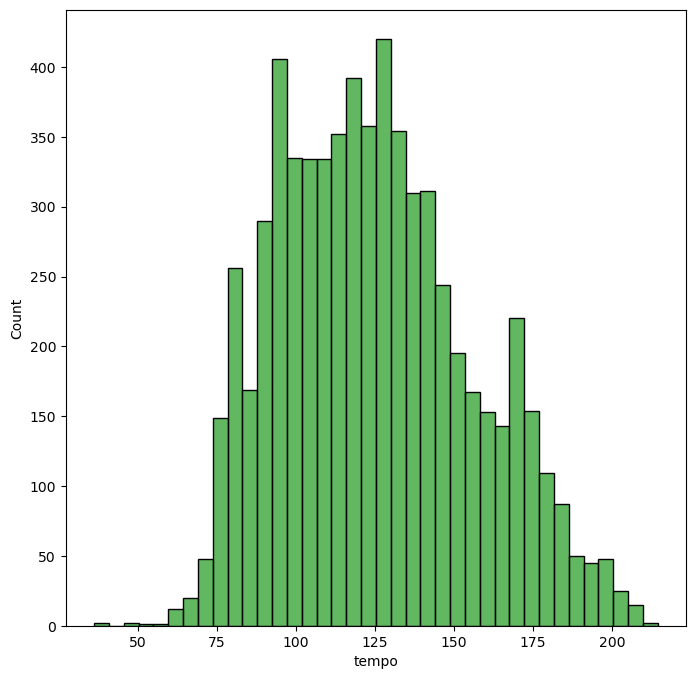

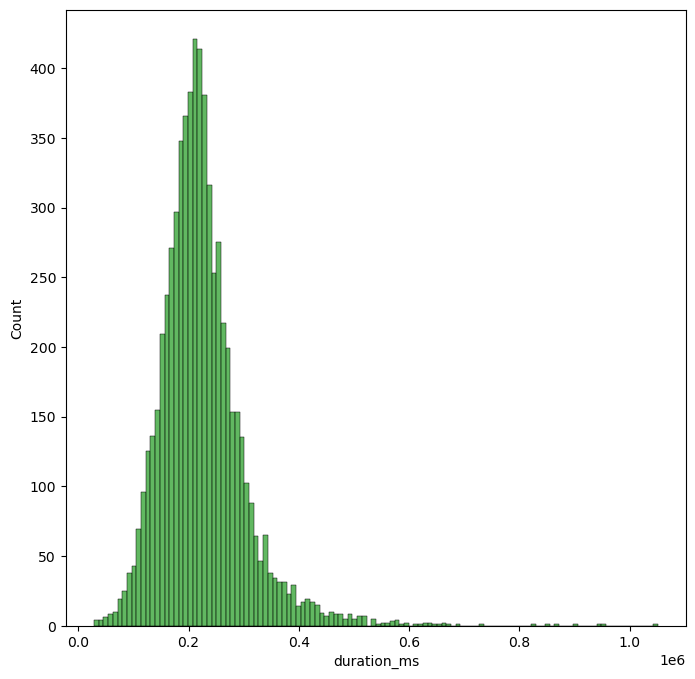

In [15]:
#Loopuing through dataframe to check distributions of numerical features
for col in num_features:
    fig, axes = plt.subplots(figsize = (8,8))
    sns.histplot(x=col, data = num_features, color="tab:green")

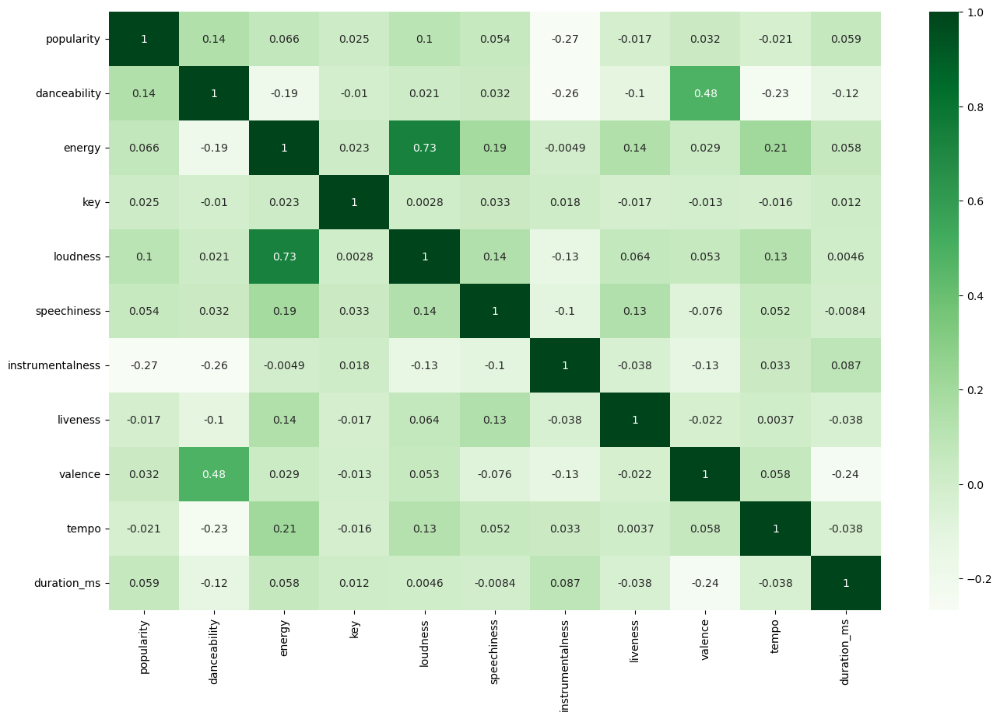

In [16]:
#Checking for correlations between features
fig, ax = plt.subplots(figsize=(16, 10))
sns.heatmap(num_features.corr(), cmap ="Greens", annot=True);

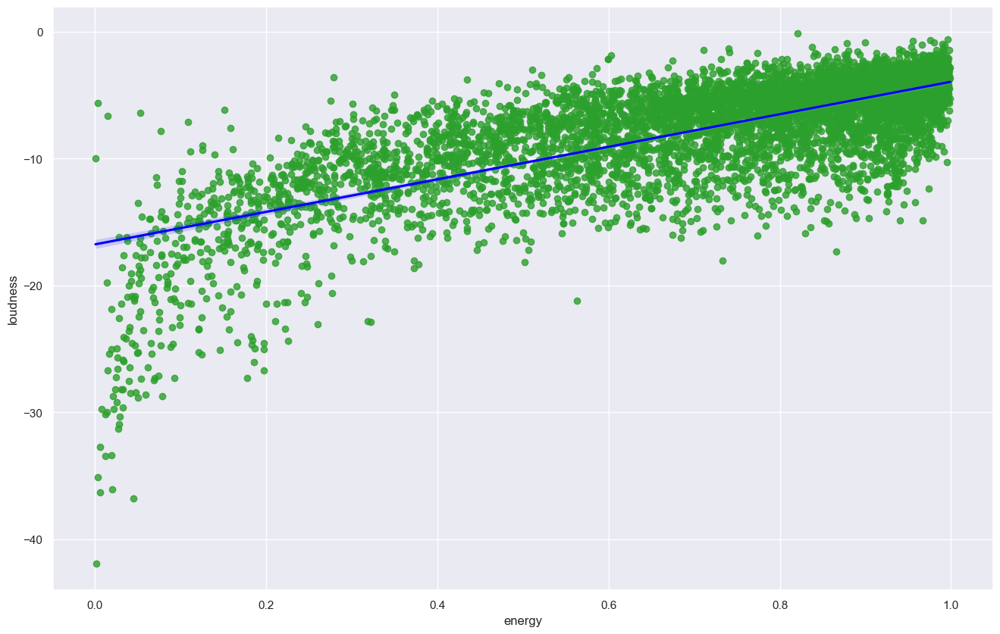

In [17]:
#Plotting relationship with most correlated features
sns.set_theme(color_codes=True)
plt.subplots(figsize=(16,10))
sns.regplot(x = 'energy', y = 'loudness', data=spot_df, scatter_kws={"color": "tab:green"}, line_kws={"color": "blue"});

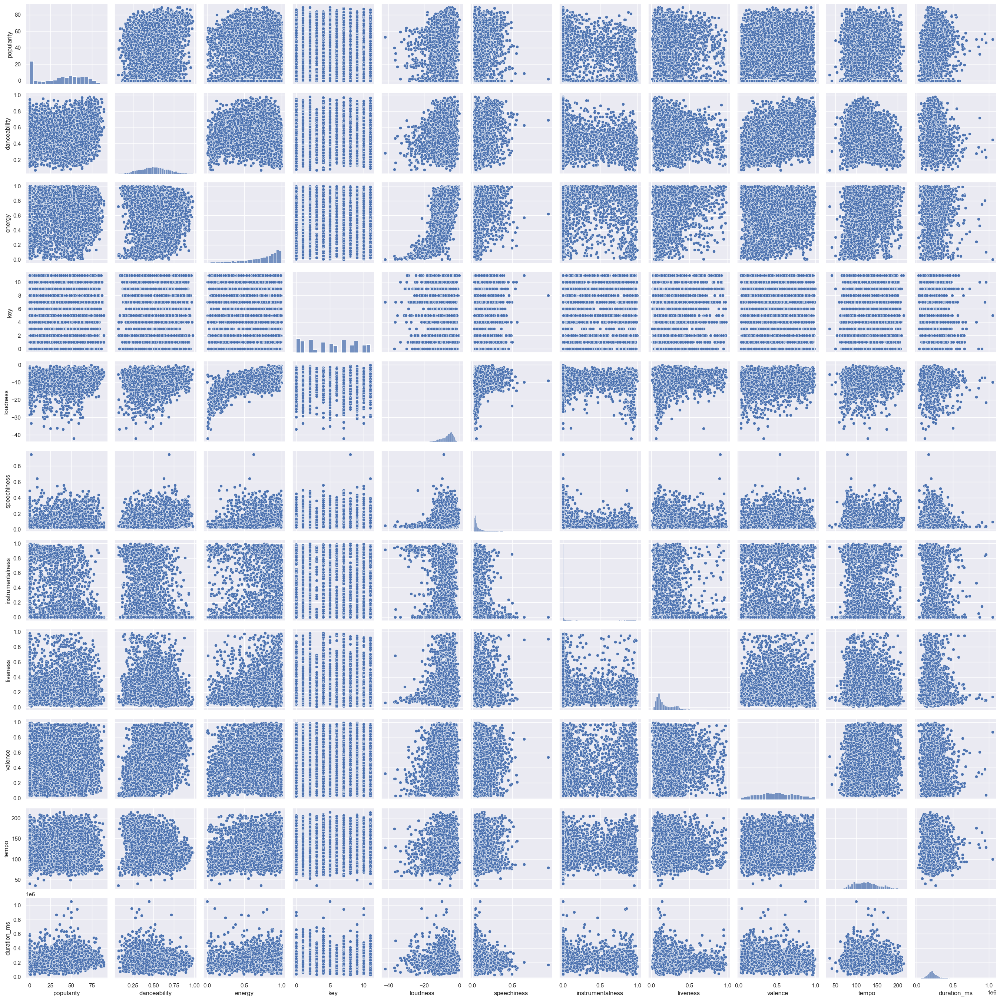

In [18]:
#Plotting relationships with features
sns.pairplot(num_features);

In [19]:
#Checking the means of top 50 songs and bottom 50 songs based on popularity
print("Top 50 Songs means\n --------------------------- \n" , num_features.sort_values(['popularity']).head(50).mean())
print("\n")
print("Bottom 50 songs means\n --------------------------- \n", num_features.sort_values(['popularity']).tail(50).mean())

Top 50 Songs means
 --------------------------- 
 popularity               0.000000
danceability             0.543240
energy                   0.793400
key                      3.980000
loudness                -5.560980
speechiness              0.078846
instrumentalness         0.047895
liveness                 0.205490
valence                  0.474420
tempo                  124.068260
duration_ms         223022.000000
dtype: float64


Bottom 50 songs means
 --------------------------- 
 popularity              84.400000
danceability             0.627200
energy                   0.675220
key                      5.520000
loudness                -6.315100
speechiness              0.093498
instrumentalness         0.026515
liveness                 0.165008
valence                  0.525280
tempo                  121.484640
duration_ms         235406.760000
dtype: float64


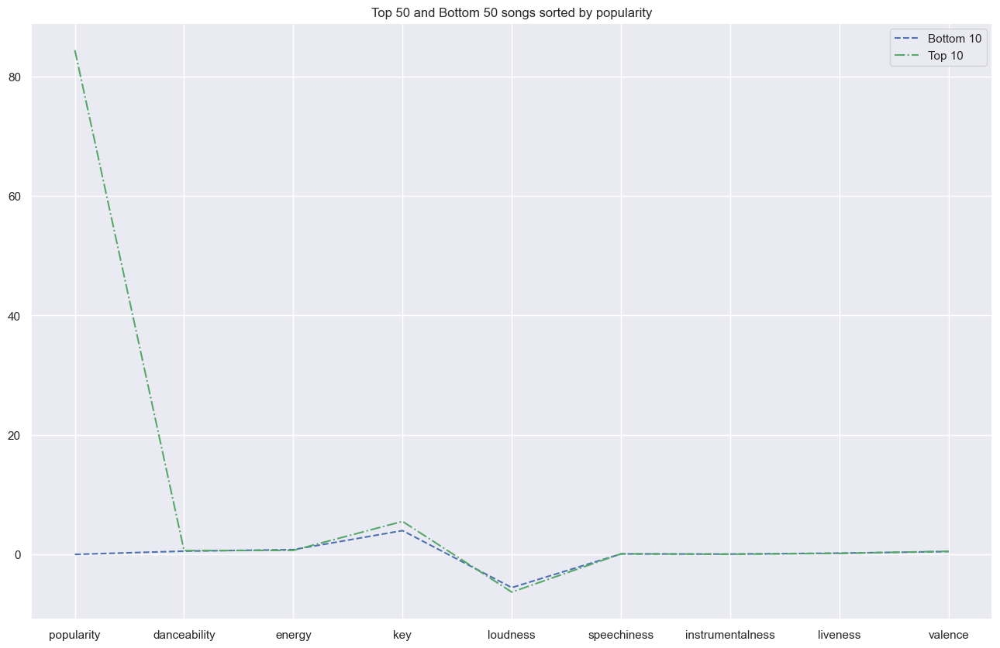

In [20]:
#Plotting the relationship of the means between the top and bottom 50 songs
fig, ax = plt.subplots(figsize=(16, 10))
plt.title('Top 50 and Bottom 50 songs sorted by popularity')
plt.plot(num_features.sort_values(['popularity']).head(50).drop(['duration_ms', 'tempo'], axis=1).mean(),
         color = "b", linestyle = '--')

plt.plot(num_features.sort_values(['popularity']).tail(50).drop(['duration_ms', 'tempo'], axis=1).mean(),
         color = "g", linestyle = "dashdot")

plt.legend(labels = ["Bottom 10", "Top 10"]);

In [21]:
#Making a copy of the original dataframe
rec_df = spot_df.copy()
rec_df.head()

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.325,0.720,122.494,249293,4
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.324,0.267,150.354,308560,4
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.119,0.172,64.223,179200,4
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.258,0.473,81.308,122067,4
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.394,0.781,122.875,224307,4


In [22]:
# Creating df with just the audio features
rec_df_features = rec_df.select_dtypes(np.number)

In [23]:
#Checking the first 5 rows of the dataframe
rec_df_features.head()

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.325,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.324,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.119,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.258,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.394,0.781,122.875,224307,4


# Modeling

In [25]:
# https://towardsdatascience.com/how-to-build-an-amazing-music-recommendation-system-4cce2719a572

def PCA_pipeline(scaler, df):
    
    """
    
    Function
    --------------------------------------
    This function converts a DataFrame to only include its numerical columns. It then scales the dataframe and uses PCA 
    to create a 2 dimensional array for plotting. The output is a DataFrame that includes the output values of the PCA 
    components along with the artist, title of the song and cluster in which it belongs to.
    
    
    """
    
    pca_pipeline = Pipeline([('scaler', scaler), ('PCA', PCA(n_components=2))])
    songs = df.select_dtypes(np.number) 
    song_embedding = pca_pipeline.fit_transform(songs)
    projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
    projection['artist'] = df['artist']
    projection['title'] = df['track_name']
    projection['cluster'] = df['cluster_label']
    return projection

In [26]:
def plot_clusters(projection, x, y):
    
    """
    
    Function
    --------------------------------------
    This function takes the data generated from the PCA_pipeline function and plots the information along with the songs
    for visual purposes
    
    """
    
    fig = px.scatter(projection, x= 'x', y= 'y', color='cluster', hover_data=['x', 'y', 'title'])
    fig.show()

In [27]:
def clustering_metrics(df_num, preds):
    
    """
    
    Function
    --------------------------------------
    This function uses the numerical columns of a DataFrame along with the predictions generated to measure the performance
    of unsupervised learning tasks
    
    """
    
    print('Silhouette Score: ', silhouette_score(df_num, preds), '\n\n -------------------------- \n\n')
    print('Calinski Harabasz Score: ', calinski_harabasz_score(df_num, preds), 
          ' \n\n -------------------------- \n\n')
    
    print('Davies Bouldin Score: ', davies_bouldin_score(df_num, preds), '\n\n -------------------------- \n\n')

In [158]:
# https://stackoverflow.com/questions/44636370/scikit-learn-gridsearchcv-without-cross-validation-unsupervised-learning

def cv_silhouette_scorer(estimator, X):
    
    """
    
    Function
    --------------------------------------
    This function calculates the silhouette score of a clustering algorithm that could be inputted to a GridSearchCV for the
    "scoring" parameter.
    
    """
    
    estimator.fit(X)
    cluster_labels = estimator['model'].labels_
    num_labels = len(set(cluster_labels))
    num_samples = len(X.index)
    if num_labels == 1 or num_labels == num_samples:
        return -1
    else:
        return silhouette_score(X, cluster_labels)

#Stops Gridsearch from crossvalidating
cv = [(slice(None), slice(None))]

## Working with UMAP

In [28]:
#Creating a copy of the dataset for modifications
umap_play_df = rec_df_features.copy()
umap_play_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [29]:
#Instantiating UMAP
reducer = umap.UMAP()

In [30]:
#Instantiating scaler
ss = StandardScaler()

In [31]:
#Scaling data
umap_play_df_scaled = ss.fit_transform(umap_play_df)

In [32]:
#Transforming scaled data using UMAP
umap_play_df_embedded = reducer.fit_transform(umap_play_df_scaled)

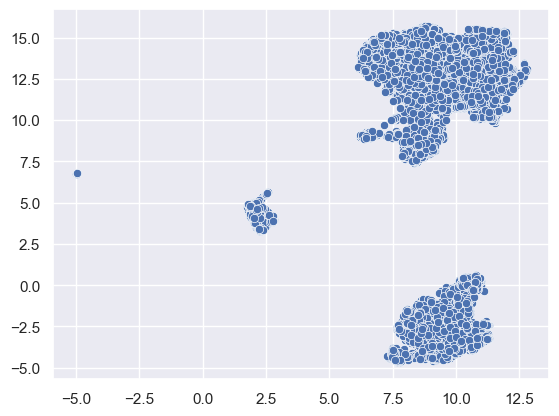

In [33]:
#Plotting output of UMAP
sns.scatterplot(x = umap_play_df_embedded[:, 0], y = umap_play_df_embedded[:, 1], data = umap_play_df_embedded);

In [34]:
#Checking to make sure the number of rows outputted match the data
np.count_nonzero(umap_play_df_embedded[:, 0])

6513

In [35]:
def draw_umap(n_neighbors=15, min_dist=0.1, n_components=2, metric='euclidean', title=''):
    
    """
    Function
    --------------------------------------
    This function takes the output of UMAP and plots the output based on the number of components.
    
    """
    fit = umap.UMAP(
        n_neighbors=n_neighbors,
        min_dist=min_dist,
        n_components=n_components,
        metric=metric
    )
    u = fit.fit_transform(umap_play_df_scaled);
    fig = plt.figure()
    if n_components == 1:
        ax = fig.add_subplot(111)
        ax.scatter(u[:,0], range(len(u)))
    if n_components == 2:
        ax = fig.add_subplot(111)
        ax.scatter(u[:,0], u[:,1])
    if n_components == 3:
        ax = fig.add_subplot(111, projection='3d')
        ax.scatter(u[:,0], u[:,1], u[:,2], s=100)
    plt.title(title, fontsize=18)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning: WARNING: spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(
C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning: WARNING: spectral initialisation failed! The eigenvector solver
failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!
  warn(


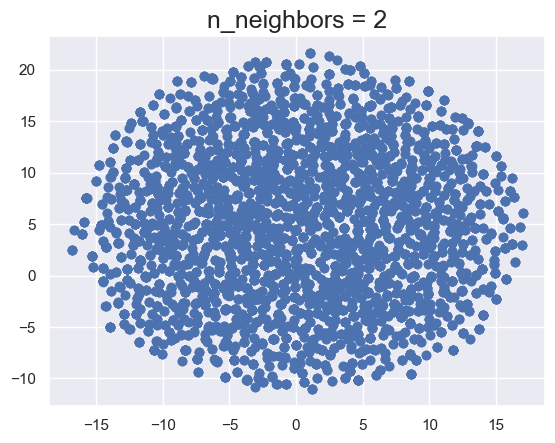

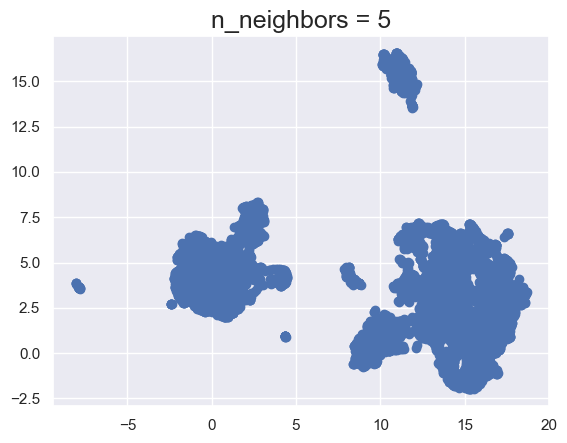

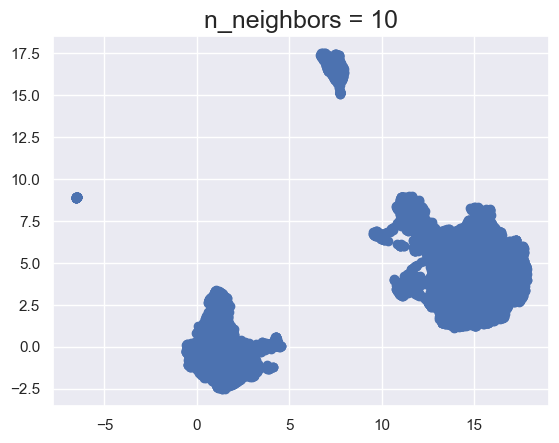

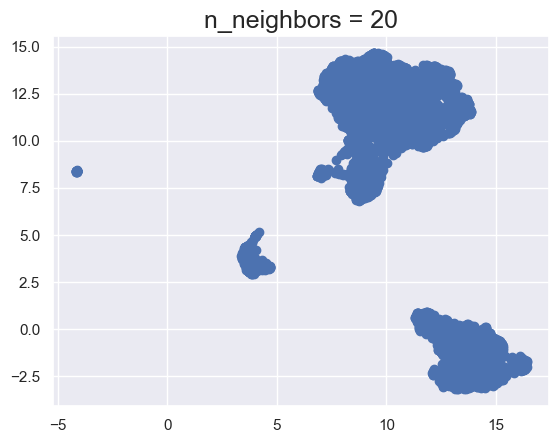

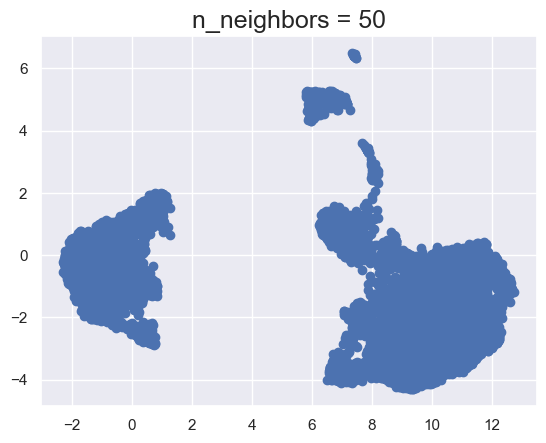

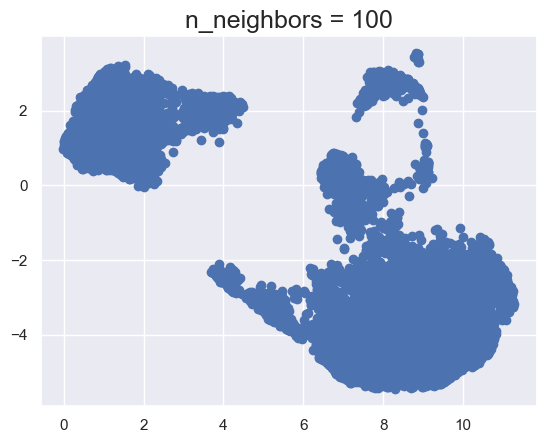

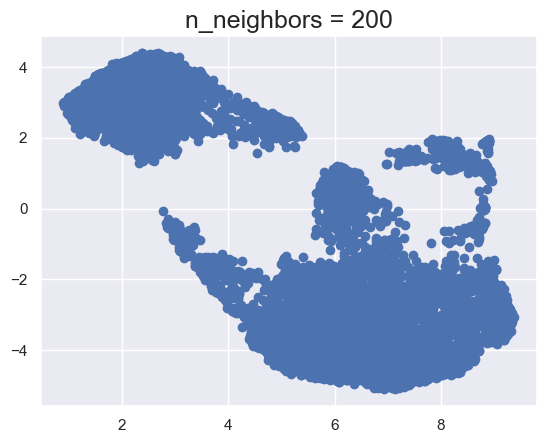

In [36]:
#Looping through n_neigbors parameter of UMAP
for n in (2, 5, 10, 20, 50, 100, 200):
    draw_umap(n_neighbors=n, title='n_neighbors = {}'.format(n), n_components=2)

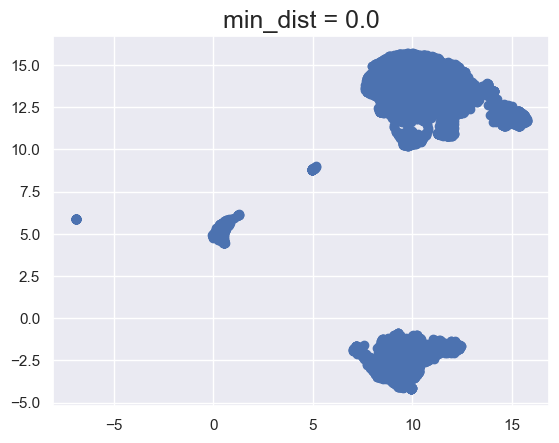

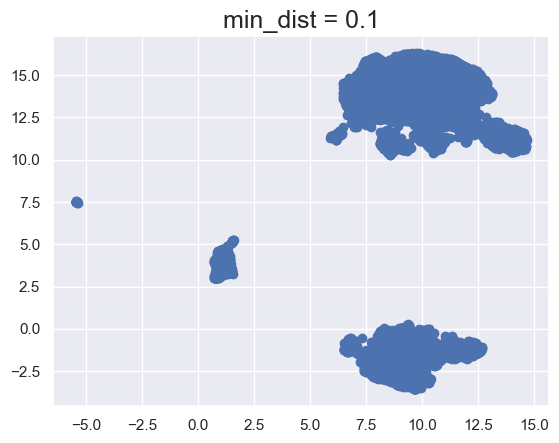

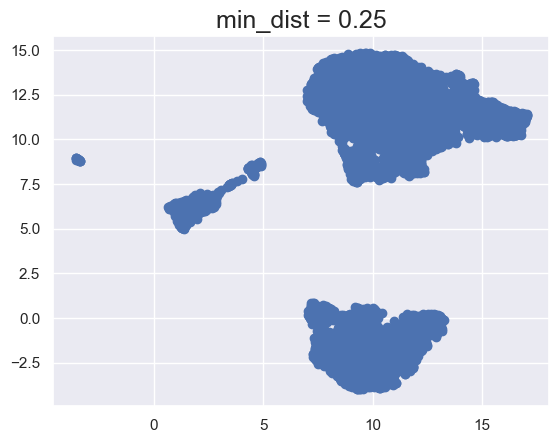

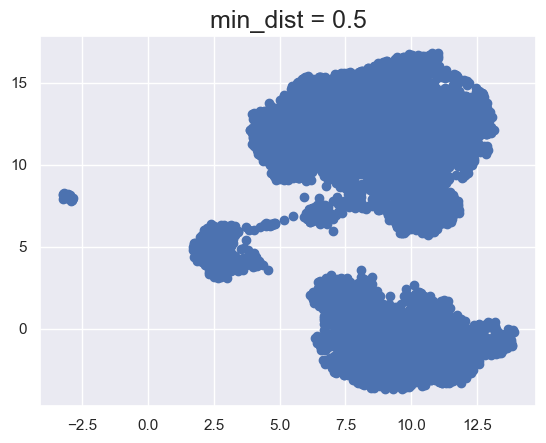

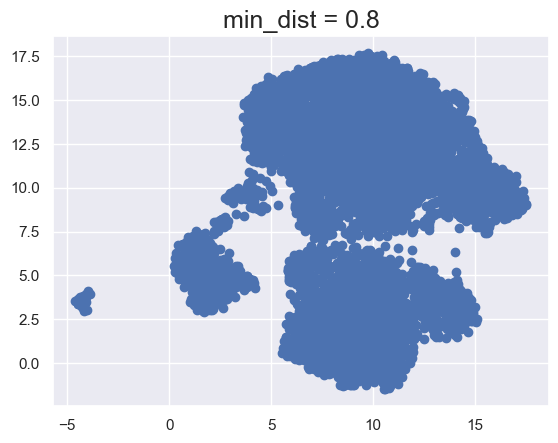

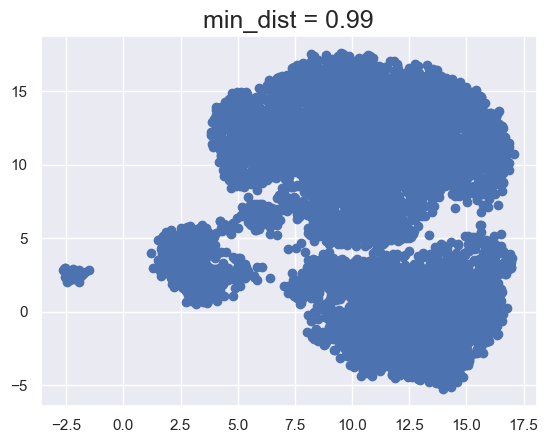

In [37]:
#Looping through min_dist parameter of UMAP
for d in (0.0, 0.1, 0.25, 0.5, 0.8, 0.99):
    draw_umap(min_dist=d, title='min_dist = {}'.format(d), n_components=2)

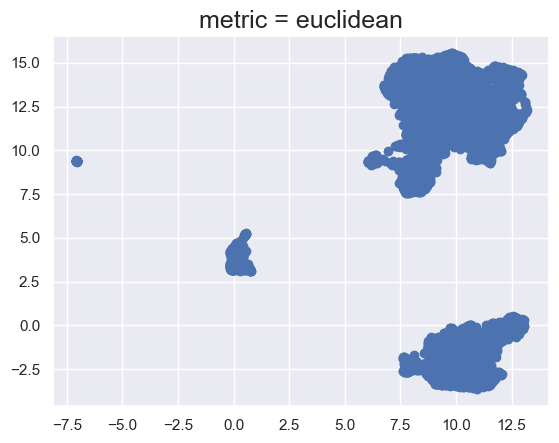

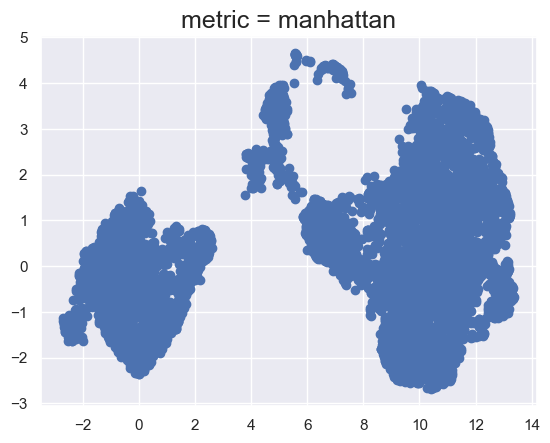

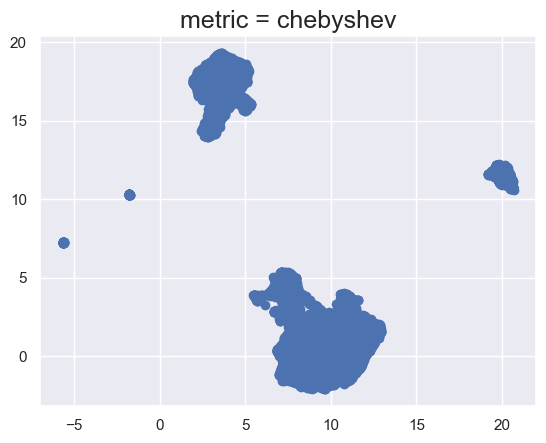

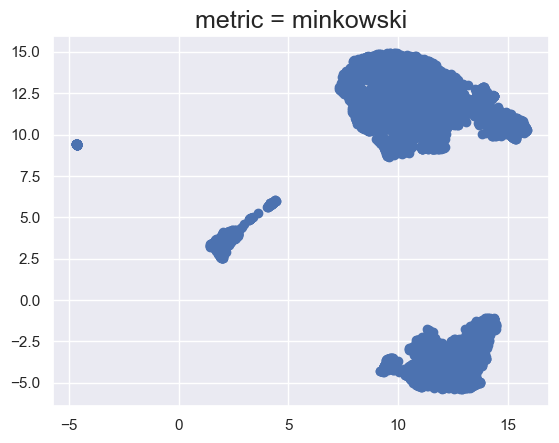

In [38]:
#Looping through metric parameter of UMAP
for m in ("euclidean", "manhattan", "chebyshev", "minkowski"):
    draw_umap(n_components=2, metric=m, title='metric = {}'.format(m))
    

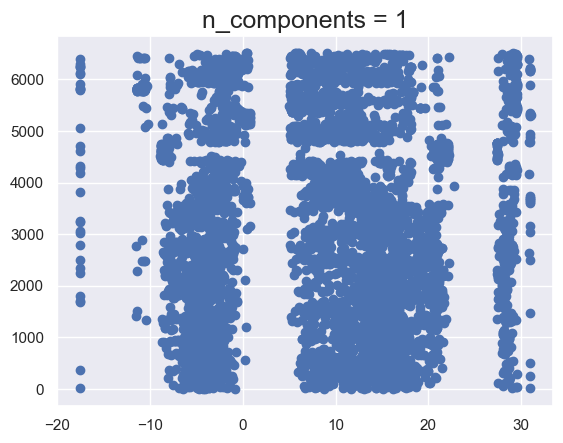

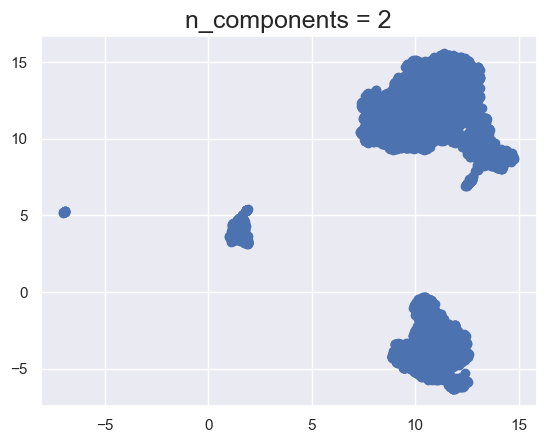

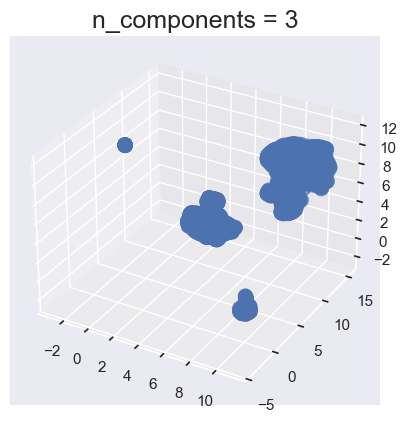

In [39]:
#Looping through n_components parameter of UMAP
for n in (1, 2, 3):
    draw_umap(n_components=n, title='n_components = {}'.format(n))

## <u>KMeans<u/>

### Baseline KMeans with no dimensionality reduction

In [225]:
#Setting up pipeline to scale data and perform kmeans on the data
kmeans_base_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                                 ('kmeans', KMeans())])

In [226]:
#Creating a copy DataFrame for modeling
kmeans_base_song_df = rec_df.select_dtypes(np.number)
kmeans_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [227]:
#Predicting clusters based on the DataFrame
song_base_labels = kmeans_base_cluster_pipeline.fit_predict(kmeans_base_song_df)

In [229]:
#Adding cluster outputs, artist and track names to the DataFrame
kmeans_base_song_df['cluster_label'] = song_base_labels
kmeans_base_song_df['artist'] = rec_df['artist']
kmeans_base_song_df['track_name'] = rec_df['track_name']

In [230]:
#Checking columns
kmeans_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label,artist,track_name
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,2,Bon Jovi,Livin' On A Prayer
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,7,Bon Jovi,Wanted Dead Or Alive
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,3,Queen,We Are The Champions - Remastered 2011
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,2,Queen,We Will Rock You - Remastered 2011
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,3,Bon Jovi,You Give Love A Bad Name
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,6,N.W.A.,Gangsta Gangsta
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,2,Various Artists,Rollin' With My Homies
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,6,Nas,N.Y. State of Mind
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,6,Nas,Nas Is Like


In [273]:
#Checking unsupervised learning metrics
clustering_metrics(kmeans_base_song_df.select_dtypes(np.number).drop('cluster_label', axis=1), song_base_labels)

Silhouette Score:  -0.12799662098433773 

 -------------------------- 


Calinski Harabasz Score:  41.18254310377404  

 -------------------------- 


Davies Bouldin Score:  81.75480528391148 

 -------------------------- 




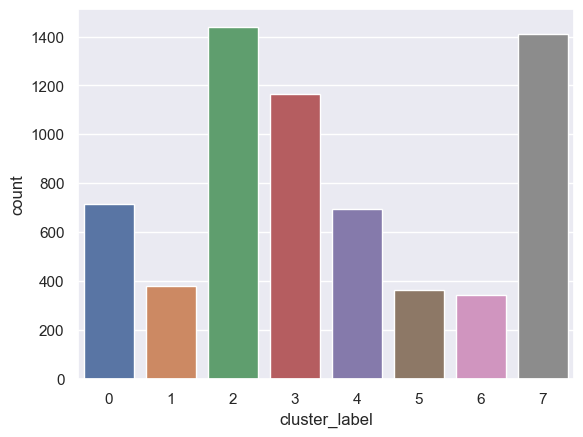

In [232]:
#Visualizing counts of songs assigned to each cluster
sns.countplot(data=kmeans_base_song_df, x = 'cluster_label');

In [233]:
#Checking how many songs are assigned to each cluster
kmeans_base_song_df['cluster_label'].value_counts()

2    1439
7    1410
3    1165
0     716
4     695
1     379
5     364
6     345
Name: cluster_label, dtype: int64

In [234]:
#Scaling and transforming data using PCA into 2 dimensions for visualization
projection_base = PCA_pipeline(StandardScaler(), kmeans_base_song_df)

In [235]:
#Visualizing points based on PCA dimensions along with song titles with plotly
plot_clusters(projection_base, 'x', 'y')

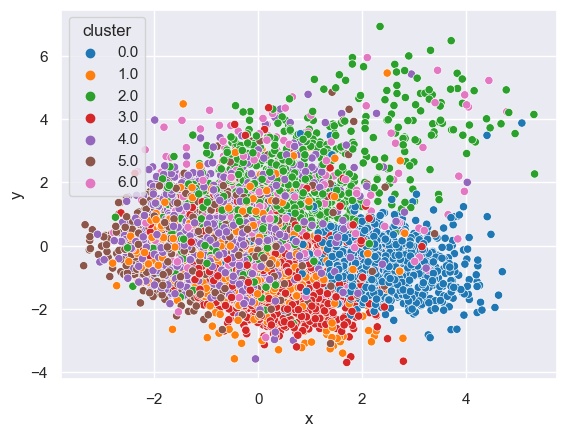

In [236]:
#Visualizing points based on PCA dimensions with seaborn
sns.scatterplot(data = projection_base, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Baseline KMeans with UMAP

In [77]:
#Setting up pipeline to scale data, do dimensionality reduction using UMAP and perform kmeans on the data
kmeans_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                            ('umap', umap.UMAP()),
                                            ('kmeans', KMeans())])

In [78]:
#Creating a copy DataFrame for modeling
kmeans_song_df = rec_df.select_dtypes(np.number)
kmeans_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [79]:
#Predicting clusters based on the DataFrame
song_cluster_labels = kmeans_cluster_pipeline.fit_predict(kmeans_song_df)

In [80]:
#Adding cluster to the DataFrame
kmeans_song_df['cluster_label'] = song_cluster_labels

In [81]:
#Checking columns
kmeans_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,0
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,0
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,1
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,5
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,5
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1


In [272]:
#Checking unsupervised learning metrics
clustering_metrics(kmeans_song_df.drop('cluster_label', axis=1), song_cluster_labels)

Silhouette Score:  -0.1549233619781077 

 -------------------------- 


Calinski Harabasz Score:  77.95285282056133  

 -------------------------- 


Davies Bouldin Score:  24.408628178065936 

 -------------------------- 




In [83]:
#Going into pipeline to get values of UMAP for visualization
kmeans_umap_db = kmeans_cluster_pipeline['umap'].transform(rec_df.select_dtypes(np.number))

In [84]:
#Inputting UMAP output into a DataFrame 
kmeans_umap_df = pd.DataFrame(kmeans_umap_db, columns=['umap_1', 'umap_2'])

In [85]:
#Inputting clusters they were assigned to
kmeans_umap_df['cluster'] = kmeans_song_df['cluster_label']

In [86]:
#Checking columns
kmeans_umap_df

,umap_1,umap_2,cluster
0,13.462135,13.727031,0.0
1,13.440999,13.709636,0.0
2,13.497426,13.710485,1.0
3,13.481073,13.723890,5.0
4,13.438591,13.693316,1.0
...,...,...,...
6508,13.473324,13.722072,5.0
6509,13.420217,13.747381,1.0
6510,13.447472,13.709420,5.0
6511,13.436381,13.718609,1.0


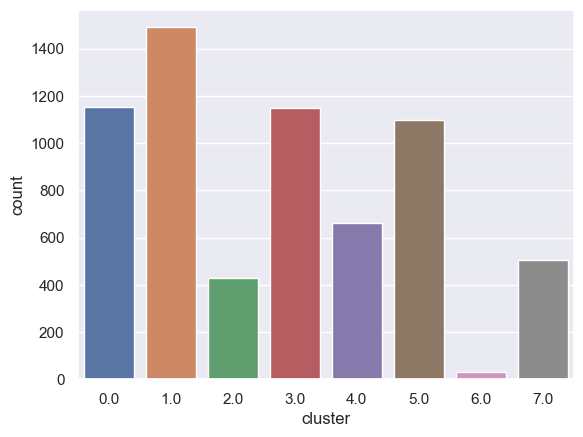

In [87]:
#Visualizing counts of songs assigned to each cluster
sns.countplot(data=kmeans_umap_df, x = 'cluster');

In [88]:
#Checking how many songs are assigned to each cluster
kmeans_umap_df['cluster'].value_counts()

1.0    1490
0.0    1152
3.0    1148
5.0    1097
4.0     660
7.0     506
2.0     427
6.0      32
Name: cluster, dtype: int64

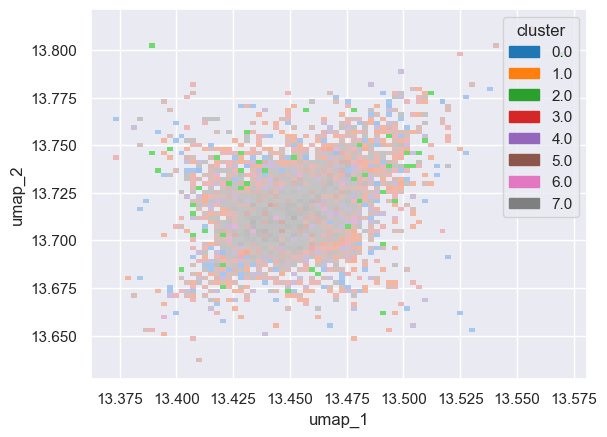

In [89]:
#Visualizing clusters using seaborn's histplot
sns.histplot(x = 'umap_1', y = 'umap_2', data = kmeans_umap_df, hue = 'cluster', palette = 'tab10');

In [90]:
#Visualizing clusters using plotly's scatterplot
px.scatter(kmeans_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

### Baseline KMeans with PCA

In [91]:
#Creating a copy DataFrame for modeling
pca_kmeans_df = rec_df.copy()

In [92]:
#Checking columns
pca_kmeans_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [93]:
#Setting up pipeline to scale data, do dimensionality reduction using PCA and perform kmeans on the data
kmeans_pca_cluster_pipeline = Pipeline([('scaler', StandardScaler()),
                                        ('pca', PCA(n_components=9)),
                                        ('kmeans', KMeans())])

In [94]:
pca_kmeans_preds = kmeans_pca_cluster_pipeline.fit_predict(pca_kmeans_df.select_dtypes(np.number))

In [95]:
pca_kmeans_preds

array([6, 2, 1, ..., 0, 0, 1])

In [96]:
kmeans_pca_cluster_pipeline['pca'].components_

array([[-0.15024599,  0.06472382, -0.62318258, -0.04052279, -0.59864311,
         0.11889898, -0.26627048,  0.13958413, -0.16639778, -0.03695767,
        -0.22428204, -0.02857896, -0.20042663],
       [-0.24426559, -0.61234131,  0.10952141,  0.01973029, -0.0391188 ,
        -0.0350763 , -0.00411959,  0.39941951,  0.08316468, -0.50924764,
         0.16689922,  0.25491224, -0.17773449],
       [ 0.40162771,  0.07881235, -0.1011505 ,  0.30852383, -0.06181144,
        -0.36924105,  0.19415123, -0.20094982, -0.07538435, -0.3538427 ,
        -0.39818197,  0.46558627,  0.05121881],
       [ 0.29846024, -0.11955139, -0.08939126, -0.40817727, -0.07770734,
         0.42499458,  0.26805794, -0.39518958,  0.40139245, -0.22698923,
        -0.02753222, -0.03940501, -0.30395722],
       [-0.26416704,  0.02985767, -0.08584518,  0.38425409, -0.14224333,
        -0.34511436,  0.4309836 ,  0.02198419,  0.47350792,  0.06926875,
        -0.05624375, -0.40729778, -0.22510819],
       [ 0.36381394, -0.151424

In [97]:
kmeans_pca_cluster_pipeline['pca'].explained_variance_ratio_

array([0.15472216, 0.14072337, 0.0965703 , 0.08836944, 0.08412183,
       0.07647209, 0.06807298, 0.0671418 , 0.06324534])

In [98]:
pca_kmeans_df['cluster_label'] = pca_kmeans_preds

In [99]:
pca_kmeans_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,6
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,2
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,1
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,6
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,0
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,6
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,0
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,0


In [100]:
projection_kmeans = PCA_pipeline(StandardScaler(), pca_kmeans_df)

In [101]:
projection_kmeans

,x,y,artist,title,cluster
0,0.293403,-0.837502,Bon Jovi,Livin' On A Prayer,6.0
1,-1.587985,1.631732,Bon Jovi,Wanted Dead Or Alive,2.0
2,-0.343699,1.024720,Queen,We Are The Champions - Remastered 2011,1.0
3,1.303773,-1.549247,Queen,We Will Rock You - Remastered 2011,6.0
4,-0.625967,-0.908883,Bon Jovi,You Give Love A Bad Name,3.0
...,...,...,...,...,...
6508,-1.477556,-1.781130,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,4.0
6509,1.885052,-1.973132,N.W.A.,Gangsta Gangsta,0.0
6510,-1.944676,-1.980511,Various Artists,Rollin' With My Homies,6.0
6511,-2.226612,-2.147401,Nas,N.Y. State of Mind,0.0


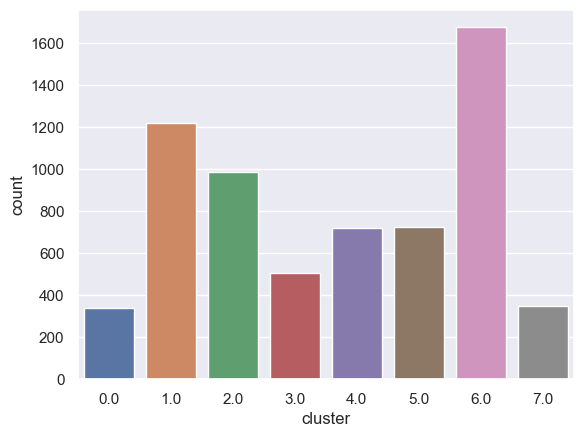

In [102]:
sns.countplot(data=projection_kmeans, x = 'cluster');

In [103]:
projection_kmeans['cluster'].value_counts()

6.0    1674
1.0    1218
2.0     987
5.0     724
4.0     721
3.0     504
7.0     347
0.0     337
Name: cluster, dtype: int64

In [104]:
plot_clusters(projection_kmeans, 'x', 'y')

In [274]:
clustering_metrics(pca_kmeans_df.select_dtypes(np.number).drop('cluster_label', axis=1), pca_kmeans_preds)

Silhouette Score:  -0.1184320552100252 

 -------------------------- 


Calinski Harabasz Score:  168.12475855890756  

 -------------------------- 


Davies Bouldin Score:  19.495345446205654 

 -------------------------- 




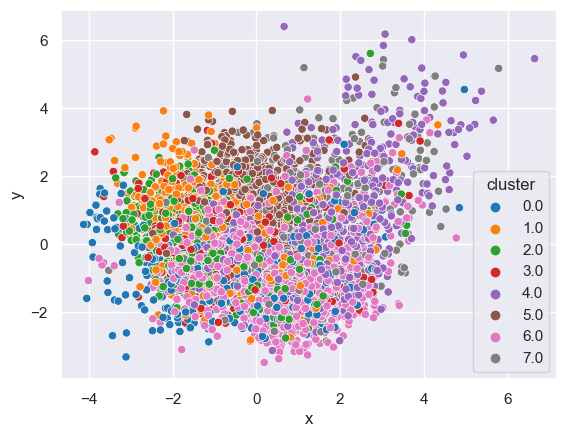

In [292]:
sns.scatterplot(data = projection_kmeans, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Gridsearch KMeans with UMAP

In [106]:
gs_kmeans_umap_df = rec_df.copy().select_dtypes(np.number) 

In [107]:
gs_kmeans_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [109]:
kmeans_pipe_gs_umap = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('umap', umap.UMAP()),
                                        ('model', KMeans())])


In [111]:
kmeans_umap_grid = {'umap__n_neighbors':[2, 50, 100],
                    'umap__min_dist':[0.5, 0.8],
                    'model__n_clusters': [7, 20, 57, 80, 107],
                    'model__n_init':[10, 50, 100],
                        }


In [112]:
kmeans_gs_umap = GridSearchCV(estimator=kmeans_pipe_gs_umap, 
                              param_grid = kmeans_umap_grid, 
                              scoring = cv_silhouette_scorer,
                             cv=cv)

In [113]:
kmeans_gs_umap.fit(gs_kmeans_umap_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('umap', UMAP()), ('model', KMeans())]),
             param_grid={'model__n_clusters': [7, 20, 57, 80, 107],
                         'model__n_init': [10, 50, 100],
                         'umap__min_dist': [0.5, 0.8],
                         'umap__n_neighbors': [2, 50, 100]},
             scoring=<function cv_silhouette_scorer at 0x000001B9BE0256C0>)

In [114]:
kmeans_gs_umap.best_params_

{'model__n_clusters': 7,
 'model__n_init': 10,
 'umap__min_dist': 0.5,
 'umap__n_neighbors': 2}

In [115]:
kmeans_gs_umap.best_score_

-0.04570800321241425

In [116]:
kmeans_gs_umap.scorer_

<function __main__.cv_silhouette_scorer(estimator, X)>

In [117]:
preds_kmeans_umap = kmeans_gs_umap.predict(gs_kmeans_umap_df)

In [118]:
preds_kmeans_umap

array([1, 0, 2, ..., 4, 3, 0])

In [119]:
gs_kmeans_umap_df['cluster'] = preds_kmeans_umap

In [120]:
gs_kmeans_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,0
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,2
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,6
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,3


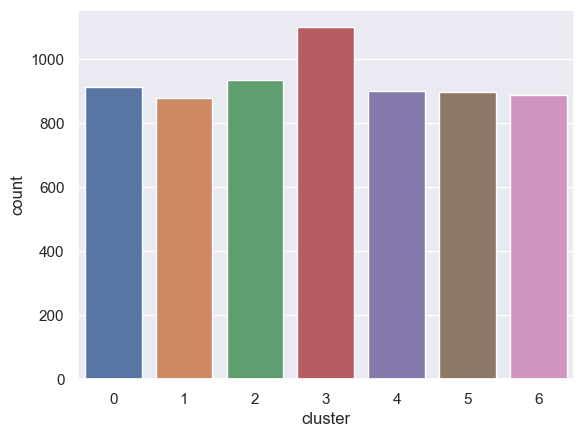

In [121]:
sns.countplot(data=gs_kmeans_umap_df, x = 'cluster');

In [122]:
gs_kmeans_umap_df['cluster'].value_counts()

3    1100
2     934
0     914
4     902
5     897
6     887
1     879
Name: cluster, dtype: int64

In [123]:
kmeans_gs_umap_db = kmeans_gs_umap.best_estimator_.named_steps['umap'].transform(gs_kmeans_umap_df.drop('cluster', axis=1))

In [124]:
kmeans_gs_umap_df = pd.DataFrame(kmeans_gs_umap_db, columns=['umap_1', 'umap_2'])

In [125]:
kmeans_gs_umap_df.isna().sum()

umap_1    0
umap_2    0
dtype: int64

In [126]:
kmeans_gs_umap_df['cluster'] = gs_kmeans_umap_df['cluster']

In [127]:
kmeans_gs_umap_df

,umap_1,umap_2,cluster
0,-6.293377,8.398407,1.0
1,-6.337462,8.304523,0.0
2,-6.527750,8.416932,2.0
3,-6.303642,8.457219,4.0
4,-6.372378,8.415193,1.0
...,...,...,...
6508,-6.307098,8.399378,4.0
6509,-6.426159,8.460101,1.0
6510,-6.440009,8.516913,6.0
6511,-6.338958,8.354441,4.0


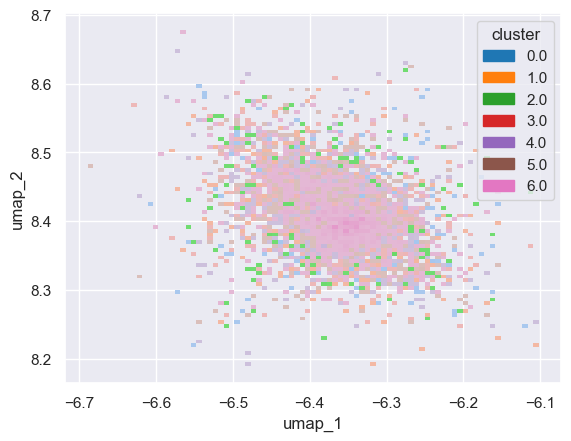

In [128]:
sns.histplot(x = 'umap_1', y = 'umap_2', data = kmeans_gs_umap_df, hue = 'cluster', palette = 'tab10');

In [129]:
px.scatter(kmeans_gs_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

### Gridsearch KMeans with PCA

In [130]:
gs_kmeans_pca_df = rec_df.copy().select_dtypes(np.number)

In [131]:
gs_kmeans_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [132]:
kmeans_pipe_gs_pca = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('pca', PCA()),
                                        ('model', KMeans())])

In [133]:
kmeans_pca_grid = {'pca__n_components':[9, 11, 13, 'mle'],
                    'model__n_clusters': [7, 20, 57, 80, 107],
                    'model__n_init':[10, 50, 100]
                  }


In [134]:
kmeans_gs_pca = GridSearchCV(estimator=kmeans_pipe_gs_pca,
                             param_grid = kmeans_pca_grid,
                             scoring = cv_silhouette_scorer,
                             cv=cv)

In [135]:
kmeans_gs_pca.fit(gs_kmeans_pca_df)

GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('pca', PCA()), ('model', KMeans())]),
             param_grid={'model__n_clusters': [7, 20, 57, 80, 107],
                         'model__n_init': [10, 50, 100],
                         'pca__n_components': [9, 11, 13, 'mle']},
             scoring=<function cv_silhouette_scorer at 0x000001B9BE0256C0>)

In [136]:
preds = kmeans_gs_pca.predict(gs_kmeans_pca_df)

In [137]:
gs_kmeans_pca_df['cluster'] = preds

In [138]:
gs_kmeans_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,3
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,5
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,5
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1


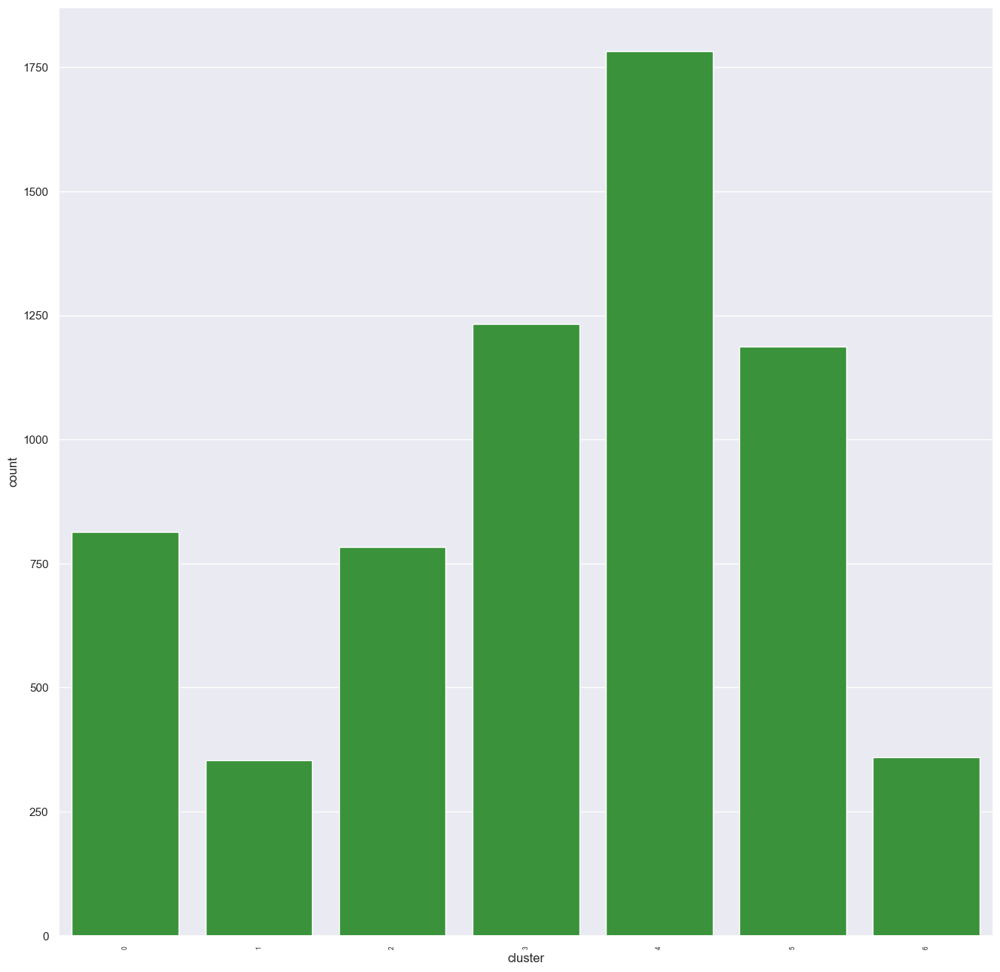

In [139]:
plt.subplots(figsize = (16, 16))
plt.xticks(rotation=90)
plt.tick_params(axis= 'x', labelsize=6)
sns.countplot(data=gs_kmeans_pca_df, x = 'cluster', orient = "h", color = 'tab:green');

In [140]:
clustering_metrics(gs_kmeans_pca_df, preds)

Silhouette Score:  -0.10473497205236547 

 -------------------------- 


Calinski Harabasz Score:  33.64288460398939  

 -------------------------- 


Davies Bouldin Score:  44.12552717490094 

 -------------------------- 




In [141]:
kmeans_gs_pca.best_params_

{'model__n_clusters': 7, 'model__n_init': 100, 'pca__n_components': 9}

In [142]:
kmeans_gs_pca.best_score_

-0.09503200695369043

In [143]:
kmeans_gs_umap.scorer_

<function __main__.cv_silhouette_scorer(estimator, X)>

In [144]:
pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])
songs = gs_kmeans_pca_df 
song_embedding = pca_pipeline.fit_transform(songs)
projection = pd.DataFrame(columns=['x', 'y'], data=song_embedding)
projection['artist'] = rec_df['artist']
projection['title'] = rec_df['track_name']
projection['cluster'] = gs_kmeans_pca_df['cluster']

In [145]:
projection

,x,y,artist,title,cluster
0,-0.625382,-0.589760,Bon Jovi,Livin' On A Prayer,4.0
1,1.479224,-1.299701,Bon Jovi,Wanted Dead Or Alive,3.0
2,-0.237561,0.811635,Queen,We Are The Champions - Remastered 2011,5.0
3,-1.554253,0.997482,Queen,We Will Rock You - Remastered 2011,4.0
4,-1.122719,-0.903701,Bon Jovi,You Give Love A Bad Name,5.0
...,...,...,...,...,...
6508,-0.983218,-0.559278,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,2.0
6509,-1.793156,1.373612,N.W.A.,Gangsta Gangsta,1.0
6510,-2.295846,-1.151556,Various Artists,Rollin' With My Homies,4.0
6511,-1.113871,-1.534729,Nas,N.Y. State of Mind,5.0


In [146]:
plot_clusters(projection, 'x', 'y')

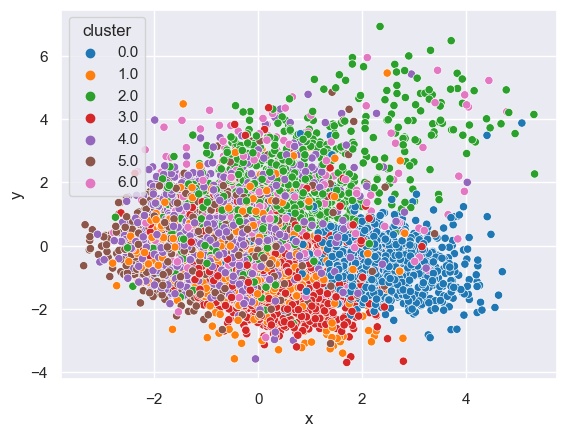

In [212]:
sns.scatterplot(data = projection, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

## <u>Agglomerative Clustering<u/>

### Baseline Aggolmerative Clustering with no dimensionality reduction

In [237]:
ac_base_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                             ('model', AgglomerativeClustering())])

In [238]:
ac_base_song_df = rec_df.select_dtypes(np.number)
ac_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [239]:
ac_song_base_labels = ac_base_cluster_pipeline.fit_predict(ac_base_song_df)

In [248]:
ac_base_song_df['cluster_label'] = ac_song_base_labels
ac_base_song_df['artist'] = rec_df['artist']
ac_base_song_df['track_name'] = rec_df['track_name']

In [249]:
ac_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label,artist,track_name
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1,Bon Jovi,Livin' On A Prayer
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,1,Bon Jovi,Wanted Dead Or Alive
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,0,Queen,We Are The Champions - Remastered 2011
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,1,Queen,We Will Rock You - Remastered 2011
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1,Bon Jovi,You Give Love A Bad Name
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1,N.W.A.,Gangsta Gangsta
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,0,Various Artists,Rollin' With My Homies
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1,Nas,N.Y. State of Mind
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1,Nas,Nas Is Like


In [275]:
clustering_metrics(ac_base_song_df.select_dtypes(np.number).drop('cluster_label', axis=1), ac_song_base_labels)

Silhouette Score:  0.08927301182941944 

 -------------------------- 


Calinski Harabasz Score:  100.20587600284416  

 -------------------------- 


Davies Bouldin Score:  5.818777208759369 

 -------------------------- 




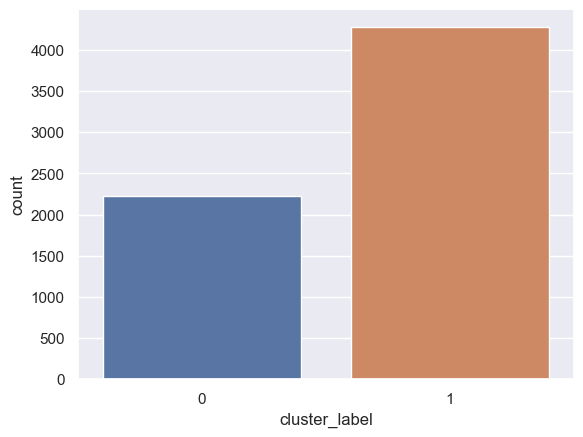

In [251]:
sns.countplot(data=ac_base_song_df, x = 'cluster_label');

In [252]:
ac_base_song_df['cluster_label'].value_counts()

1    4282
0    2231
Name: cluster_label, dtype: int64

In [253]:
projection_ac_base = PCA_pipeline(StandardScaler(), ac_base_song_df)

In [254]:
plot_clusters(projection_ac_base, 'x', 'y')

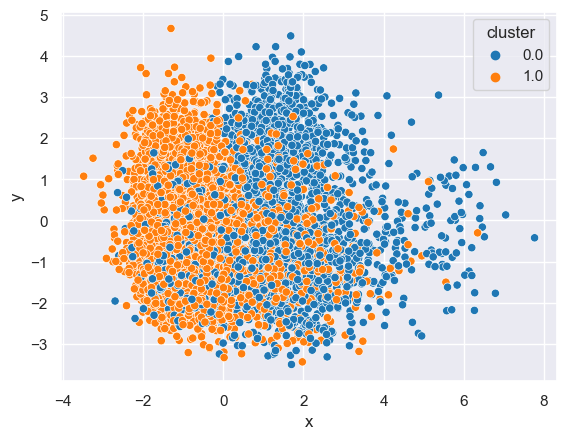

In [255]:
sns.scatterplot(data = projection_ac_base, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Baseline Aggolmerative Clustering with UMAP

In [256]:
ac_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('umap', umap.UMAP()),
                                        ('model', AgglomerativeClustering())])

In [257]:
ac_umap_song_df = rec_df.select_dtypes(np.number)
ac_umap_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [258]:
ac_umap_song_cluster_labels = ac_cluster_pipeline.fit_predict(ac_umap_song_df)

In [259]:
ac_umap_song_df['cluster_label'] = ac_umap_song_cluster_labels

In [260]:
ac_umap_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,1
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,0
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,1
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,0
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,1
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,0
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,0


In [276]:
clustering_metrics(ac_umap_song_df.drop('cluster_label', axis=1), ac_umap_song_cluster_labels)

Silhouette Score:  -0.0005855498319593209 

 -------------------------- 


Calinski Harabasz Score:  8.803126890865302  

 -------------------------- 


Davies Bouldin Score:  18.25932963698059 

 -------------------------- 




In [262]:
ac_umap_db = ac_cluster_pipeline['umap'].transform(rec_df.select_dtypes(np.number))

In [263]:
ac_umap_df = pd.DataFrame(ac_umap_db, columns=['umap_1', 'umap_2'])

In [264]:
ac_umap_df['cluster'] = ac_umap_song_df['cluster_label']

In [265]:
ac_umap_df

,umap_1,umap_2,cluster
0,12.861847,10.332652,1.0
1,12.876122,10.320251,1.0
2,12.883279,10.328020,0.0
3,12.871107,10.333032,1.0
4,12.876982,10.325894,0.0
...,...,...,...
6508,12.859846,10.325421,1.0
6509,12.897505,10.359548,0.0
6510,12.883256,10.331155,1.0
6511,12.889935,10.314505,0.0


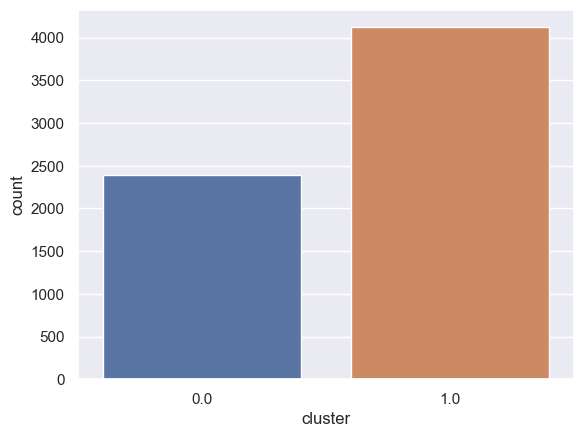

In [266]:
sns.countplot(data=ac_umap_df, x = 'cluster');

In [267]:
ac_umap_df['cluster'].value_counts()

1.0    4121
0.0    2391
Name: cluster, dtype: int64

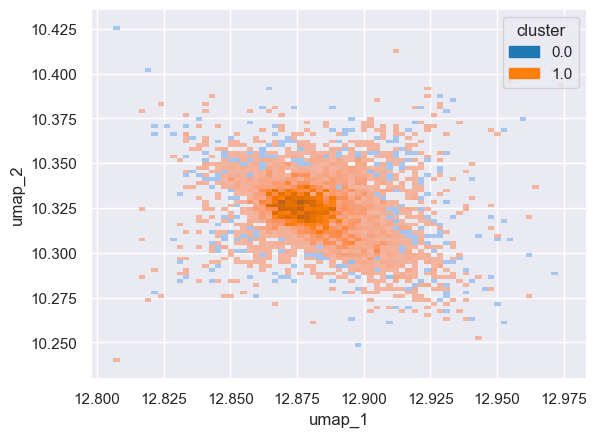

In [268]:
sns.histplot(x = 'umap_1', y = 'umap_2', data = ac_umap_df, hue = 'cluster', palette = 'tab10');

In [269]:
px.scatter(ac_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

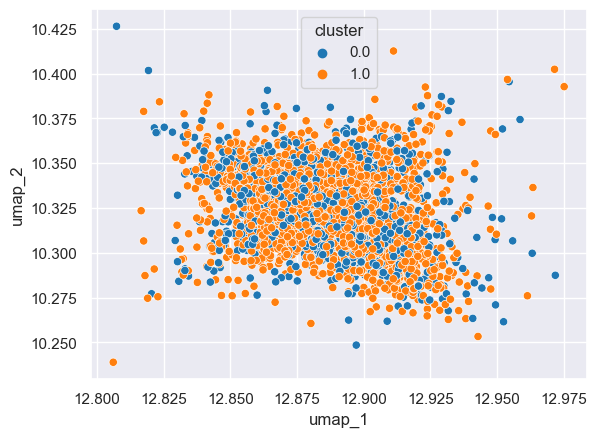

In [271]:
sns.scatterplot(data = ac_umap_df, x = 'umap_1', y='umap_2', hue = 'cluster', palette = 'tab10');

### Baseline Aggolmerative Clustering with PCA

In [277]:
pca_ac_df = rec_df.copy()

In [278]:
pca_ac_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [279]:
ac_pca_cluster_pipeline = Pipeline([('scaler', StandardScaler()),
                                        ('pca', PCA(n_components=9)),
                                        ('model', AgglomerativeClustering())])

In [280]:
pca_ac_preds = ac_pca_cluster_pipeline.fit_predict(pca_ac_df.select_dtypes(np.number))

In [281]:
pca_ac_preds

array([1, 1, 1, ..., 1, 1, 0], dtype=int64)

In [282]:
ac_pca_cluster_pipeline['pca'].components_

array([[-0.15024599,  0.06472382, -0.62318258, -0.04052279, -0.59864311,
         0.11889898, -0.26627048,  0.13958413, -0.16639778, -0.03695767,
        -0.22428204, -0.02857896, -0.20042663],
       [-0.24426559, -0.61234131,  0.10952141,  0.01973029, -0.0391188 ,
        -0.0350763 , -0.00411959,  0.39941951,  0.08316468, -0.50924764,
         0.16689922,  0.25491224, -0.17773449],
       [ 0.40162771,  0.07881235, -0.1011505 ,  0.30852383, -0.06181144,
        -0.36924105,  0.19415123, -0.20094982, -0.07538435, -0.3538427 ,
        -0.39818197,  0.46558627,  0.05121881],
       [ 0.29846024, -0.11955139, -0.08939126, -0.40817727, -0.07770734,
         0.42499458,  0.26805794, -0.39518958,  0.40139245, -0.22698923,
        -0.02753222, -0.03940501, -0.30395722],
       [-0.26416704,  0.02985767, -0.08584518,  0.38425409, -0.14224333,
        -0.34511436,  0.4309836 ,  0.02198419,  0.47350792,  0.06926875,
        -0.05624375, -0.40729778, -0.22510819],
       [ 0.36381394, -0.151424

In [283]:
ac_pca_cluster_pipeline['pca'].explained_variance_ratio_

array([0.15472216, 0.14072337, 0.0965703 , 0.08836944, 0.08412183,
       0.07647209, 0.06807298, 0.0671418 , 0.06324534])

In [284]:
pca_ac_df['cluster_label'] = pca_ac_preds

In [285]:
pca_ac_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,1
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,1
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,1
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,0
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1


In [286]:
projection_ac_pca = PCA_pipeline(StandardScaler(), pca_ac_df)

In [287]:
projection_ac_pca

,x,y,artist,title,cluster
0,-0.937668,-0.438002,Bon Jovi,Livin' On A Prayer,1.0
1,-1.194400,1.960419,Bon Jovi,Wanted Dead Or Alive,1.0
2,0.297742,0.605245,Queen,We Are The Champions - Remastered 2011,1.0
3,0.312993,-1.778853,Queen,We Will Rock You - Remastered 2011,1.0
4,-1.316127,-0.546468,Bon Jovi,You Give Love A Bad Name,1.0
...,...,...,...,...,...
6508,-1.015450,-2.050202,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,0.0
6509,1.692200,-2.276670,N.W.A.,Gangsta Gangsta,1.0
6510,-1.679929,-1.948266,Various Artists,Rollin' With My Homies,0.0
6511,-1.783991,-2.129008,Nas,N.Y. State of Mind,1.0


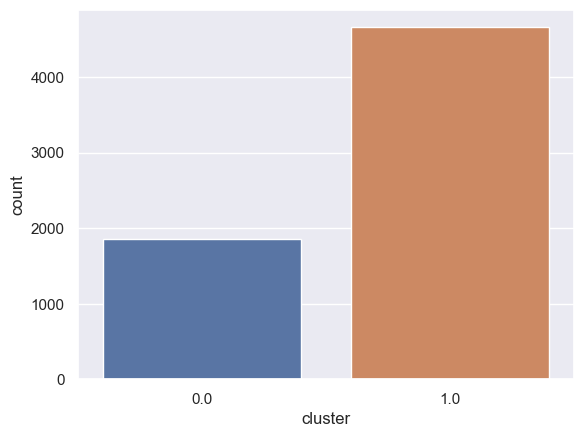

In [288]:
sns.countplot(data=projection_ac_pca, x = 'cluster');

In [289]:
projection_ac_pca['cluster'].value_counts()

1.0    4659
0.0    1853
Name: cluster, dtype: int64

In [290]:
plot_clusters(projection_ac_pca, 'x', 'y')

In [291]:
clustering_metrics(pca_ac_df.select_dtypes(np.number).drop('cluster_label', axis=1), pca_ac_preds)

Silhouette Score:  0.016676632621063118 

 -------------------------- 


Calinski Harabasz Score:  79.05426376300946  

 -------------------------- 


Davies Bouldin Score:  5.7387806473169025 

 -------------------------- 




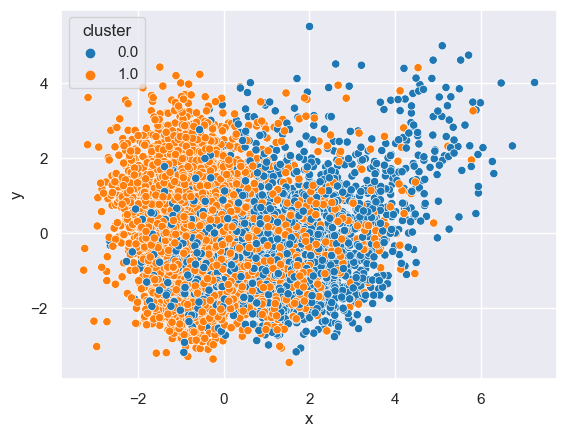

In [293]:
sns.scatterplot(data = projection_ac_pca, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Gridsearch Aggolmerative Clustering with UMAP

In [294]:
gs_ac_umap_df = rec_df.copy().select_dtypes(np.number)

In [295]:
gs_ac_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [296]:
ac_pipe_gs_umap = Pipeline(steps = [('scaler', StandardScaler()),
                                    ('umap', umap.UMAP()),
                                    ('model', AgglomerativeClustering())])


In [297]:
ac_umap_grid = {'umap__n_neighbors':[2, 50, 100],
                    'umap__min_dist':[0.5, 0.8],
                    'model__n_clusters': [7, 20, 57, 80, 107],
                    'model__affinity':['euclidean', 'l1', 'l2', 'manhattan', 'cosine', 'precomputed'],
                        }


In [298]:
ac_gs_umap = GridSearchCV(estimator= ac_pipe_gs_umap, 
                              param_grid = ac_umap_grid, 
                              scoring = cv_silhouette_scorer,
                             cv=cv)

In [299]:
ac_gs_umap.fit(gs_ac_umap_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!



GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('umap', UMAP()),
                                       ('model', AgglomerativeClustering())]),
             param_grid={'model__affinity': ['euclidean', 'l1', 'l2',
                                             'manhattan', 'cosine',
                                             'precomputed'],
                         'model__n_clusters': [7, 20, 57, 80, 107],
                         'umap__min_dist': [0.5, 0.8],
                         'umap__n_neighbors': [2, 50, 100]},
             scoring=<function cv_silhouette_scorer at 0x000001B9823430A0>)

In [300]:
ac_gs_umap.best_params_

{'model__affinity': 'euclidean',
 'model__n_clusters': 7,
 'umap__min_dist': 0.8,
 'umap__n_neighbors': 2}

In [301]:
ac_gs_umap.best_score_

-0.07854007811472986

In [302]:
ac_gs_umap.scorer_

<function __main__.cv_silhouette_scorer(estimator, X)>

In [308]:
preds_ac_umap = ac_gs_umap.best_estimator_.named_steps['model'].fit_predict(gs_ac_umap_df)

In [309]:
preds_ac_umap

array([1, 6, 2, ..., 3, 1, 1], dtype=int64)

In [310]:
gs_ac_umap_df['cluster'] = preds_ac_umap

In [311]:
gs_ac_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,6
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,2
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,5
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,6
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,1
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,3
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1


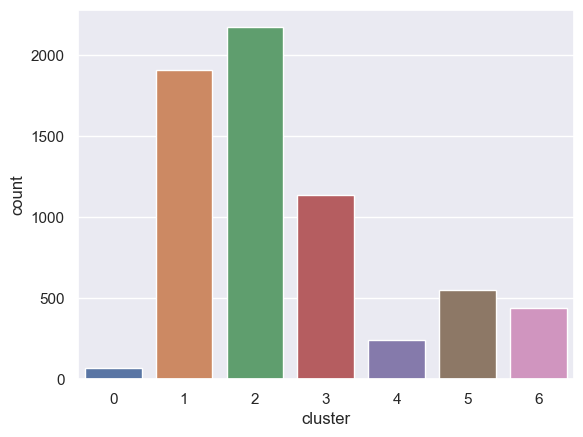

In [312]:
sns.countplot(data=gs_ac_umap_df, x = 'cluster');

In [313]:
gs_ac_umap_df['cluster'].value_counts()

2    2169
1    1908
3    1135
5     553
6     439
4     242
0      67
Name: cluster, dtype: int64

In [314]:
ac_gs_umap_db = ac_gs_umap.best_estimator_.named_steps['umap'].transform(gs_ac_umap_df.drop('cluster', axis=1))

In [315]:
ac_gs_umap_df = pd.DataFrame(ac_gs_umap_db, columns=['umap_1', 'umap_2'])

In [316]:
ac_gs_umap_df.isna().sum()

umap_1    0
umap_2    0
dtype: int64

In [317]:
ac_gs_umap_df['cluster'] = gs_ac_umap_df['cluster']

In [318]:
ac_gs_umap_df

,umap_1,umap_2,cluster
0,3.371789,0.762713,1.0
1,3.156774,0.651208,6.0
2,3.334969,0.778328,2.0
3,3.367810,0.602019,5.0
4,3.304591,0.811467,1.0
...,...,...,...
6508,3.361282,0.715016,2.0
6509,3.406747,0.400196,6.0
6510,3.518672,0.707130,1.0
6511,3.392503,0.817652,3.0


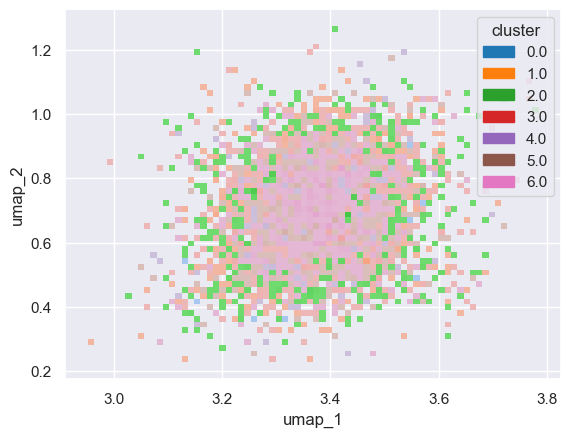

In [319]:
sns.histplot(x = 'umap_1', y = 'umap_2', data = ac_gs_umap_df, hue = 'cluster', palette = 'tab10');

In [320]:
px.scatter(ac_gs_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

### Gridsearch Aggolmerative Clustering with PCA

In [347]:
gs_ac_pca_df = rec_df.copy().select_dtypes(np.number)

In [348]:
gs_ac_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [349]:
ac_pipe_gs_pca = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('pca', PCA()),
                                        ('model', AgglomerativeClustering())])

In [350]:
ac_pca_grid = {'pca__n_components':[9, 11, 13, 'mle'],
                    'model__n_clusters': [7, 20, 57, 80, 107],
                  }


In [351]:
ac_gs_pca = GridSearchCV(estimator=ac_pipe_gs_pca,
                             param_grid = ac_pca_grid,
                             scoring = cv_silhouette_scorer,
                             cv=cv)

In [352]:
ac_gs_pca.fit(gs_ac_pca_df)

GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('pca', PCA()),
                                       ('model', AgglomerativeClustering())]),
             param_grid={'model__n_clusters': [7, 20, 57, 80, 107],
                         'pca__n_components': [9, 11, 13, 'mle']},
             scoring=<function cv_silhouette_scorer at 0x000001B9823430A0>)

In [366]:
ac_pca_preds = ac_gs_pca.best_estimator_.named_steps['model'].fit_predict(gs_ac_pca_df)

In [367]:
gs_ac_pca_df['cluster'] = ac_pca_preds

In [368]:
gs_ac_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,6
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,2
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,5
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,6
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,1
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,3
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1


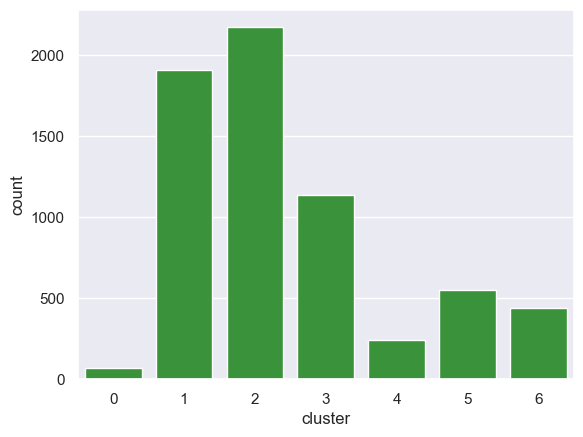

In [369]:
sns.countplot(data=gs_ac_pca_df, x = 'cluster', orient = "h", color = 'tab:green');

In [370]:
clustering_metrics(gs_ac_pca_df.drop('cluster', axis=1), ac_pca_preds)

Silhouette Score:  0.5044593226187063 

 -------------------------- 


Calinski Harabasz Score:  13125.09891745783  

 -------------------------- 


Davies Bouldin Score:  0.5575395794858196 

 -------------------------- 




In [371]:
ac_gs_pca.best_params_

{'model__n_clusters': 7, 'pca__n_components': 13}

In [372]:
ac_gs_pca.best_score_

-0.10026954882713847

In [373]:
ac_gs_pca.scorer_

<function __main__.cv_silhouette_scorer(estimator, X)>

In [374]:
ac_pca_pipeline = Pipeline([('scaler', StandardScaler()), ('PCA', PCA(n_components=2))])

songs_ac_pca = gs_ac_pca_df 
song_embedding_ac_pca = ac_pca_pipeline.fit_transform(songs_ac_pca)
projection_ac_pca = pd.DataFrame(columns=['x', 'y'], data=song_embedding_ac_pca)

projection_ac_pca['artist'] = rec_df['artist']
projection_ac_pca['title'] = rec_df['track_name']
projection_ac_pca['cluster'] = gs_ac_pca_df['cluster']

In [375]:
projection_ac_pca

,x,y,artist,title,cluster
0,-0.837014,-0.484292,Bon Jovi,Livin' On A Prayer,1.0
1,-0.469186,2.535595,Bon Jovi,Wanted Dead Or Alive,6.0
2,0.806836,0.353510,Queen,We Are The Champions - Remastered 2011,2.0
3,0.592778,-1.552659,Queen,We Will Rock You - Remastered 2011,5.0
4,-1.236322,-0.512112,Bon Jovi,You Give Love A Bad Name,1.0
...,...,...,...,...,...
6508,-0.774148,-1.324343,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,2.0
6509,0.584223,-2.556335,N.W.A.,Gangsta Gangsta,6.0
6510,-1.741924,-1.461504,Various Artists,Rollin' With My Homies,1.0
6511,-2.084951,-1.832363,Nas,N.Y. State of Mind,3.0


In [376]:
plot_clusters(projection_ac_pca, 'x', 'y')

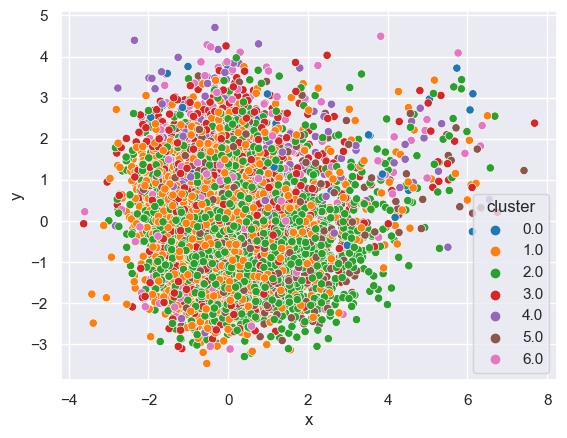

In [377]:
sns.scatterplot(data = projection_ac_pca, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

## <u>Birch<u/>

### Baseline Birch Clustering with no dimensionality reduction

In [378]:
birch_base_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                                ('model', Birch())])

In [379]:
birch_base_song_df = rec_df.select_dtypes(np.number)
birch_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [380]:
birch_song_base_labels = birch_base_cluster_pipeline.fit_predict(birch_base_song_df)

In [381]:
birch_base_song_df['cluster_label'] = birch_song_base_labels
birch_base_song_df['artist'] = rec_df['artist']
birch_base_song_df['track_name'] = rec_df['track_name']

In [382]:
birch_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label,artist,track_name
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1,Bon Jovi,Livin' On A Prayer
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,1,Bon Jovi,Wanted Dead Or Alive
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,0,Queen,We Are The Champions - Remastered 2011
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,1,Queen,We Will Rock You - Remastered 2011
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1,Bon Jovi,You Give Love A Bad Name
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1,N.W.A.,Gangsta Gangsta
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,1,Various Artists,Rollin' With My Homies
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1,Nas,N.Y. State of Mind
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1,Nas,Nas Is Like


In [383]:
clustering_metrics(birch_base_song_df.select_dtypes(np.number).drop('cluster_label', axis=1), birch_song_base_labels)

Silhouette Score:  -0.08702959262029554 

 -------------------------- 


Calinski Harabasz Score:  38.554239474990744  

 -------------------------- 


Davies Bouldin Score:  9.457742584876014 

 -------------------------- 




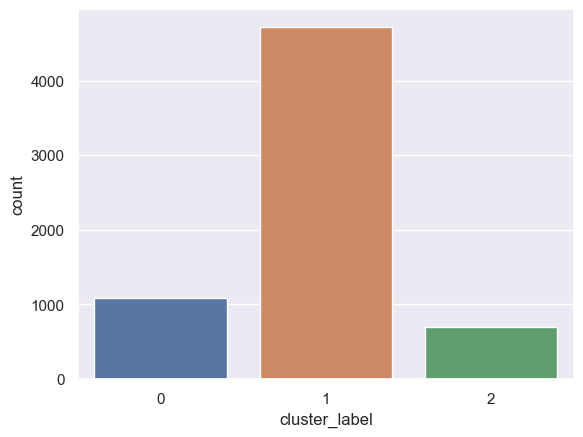

In [384]:
sns.countplot(data=birch_base_song_df, x = 'cluster_label');

In [385]:
birch_base_song_df['cluster_label'].value_counts()

1    4721
0    1092
2     700
Name: cluster_label, dtype: int64

In [386]:
projection_birch_base = PCA_pipeline(StandardScaler(), birch_base_song_df)

In [387]:
plot_clusters(projection_birch_base, 'x', 'y')

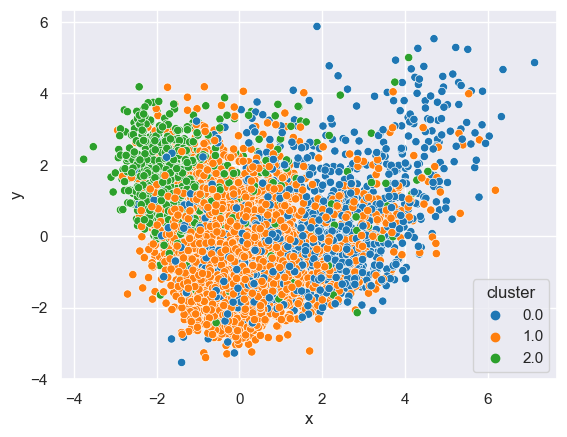

In [388]:
sns.scatterplot(data = projection_birch_base, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Baseline Birch Clustering with UMAP

In [389]:
birch_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('umap', umap.UMAP()),
                                        ('model', Birch())])

In [390]:
birch_umap_song_df = rec_df.select_dtypes(np.number)
birch_umap_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [391]:
birch_umap_song_cluster_labels = birch_cluster_pipeline.fit_predict(birch_umap_song_df)

In [392]:
birch_umap_song_df['cluster_label'] = birch_umap_song_cluster_labels

In [393]:
birch_umap_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,0
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,0
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,1
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,0
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,0
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1


In [394]:
clustering_metrics(birch_umap_song_df.drop('cluster_label', axis=1), birch_umap_song_cluster_labels)

Silhouette Score:  -0.02005249079379401 

 -------------------------- 


Calinski Harabasz Score:  8.069711428835085  

 -------------------------- 


Davies Bouldin Score:  30.49825295929963 

 -------------------------- 




In [395]:
birch_umap_db = birch_cluster_pipeline['umap'].transform(rec_df.select_dtypes(np.number))

In [396]:
birch_umap_df = pd.DataFrame(birch_umap_db, columns=['umap_1', 'umap_2'])

In [397]:
birch_umap_df['cluster'] = birch_umap_song_df['cluster_label']

In [398]:
birch_umap_df

,umap_1,umap_2,cluster
0,8.081982,9.352815,0.0
1,8.088148,9.366806,0.0
2,8.066837,9.345835,1.0
3,8.069042,9.331226,0.0
4,8.046777,9.330807,1.0
...,...,...,...
6508,8.083866,9.363175,0.0
6509,8.078422,9.316192,1.0
6510,8.057842,9.358659,0.0
6511,8.055908,9.349826,1.0


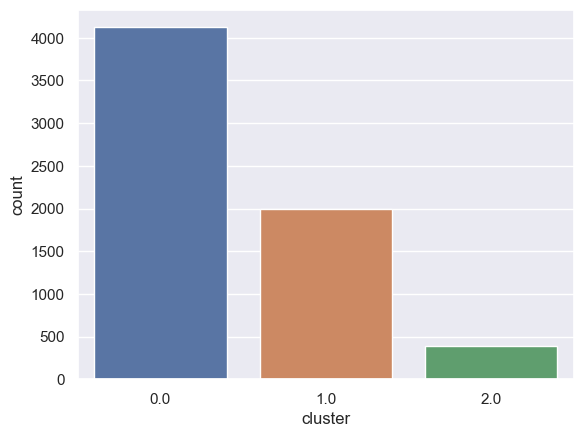

In [399]:
sns.countplot(data=birch_umap_df, x = 'cluster');

In [400]:
birch_umap_df['cluster'].value_counts()

0.0    4123
1.0    1995
2.0     394
Name: cluster, dtype: int64

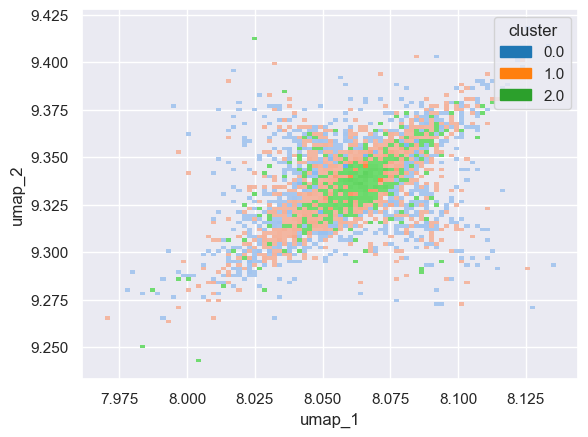

In [401]:
sns.histplot(x = 'umap_1', y = 'umap_2', data = birch_umap_df, hue = 'cluster', palette = 'tab10');

In [402]:
px.scatter(birch_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

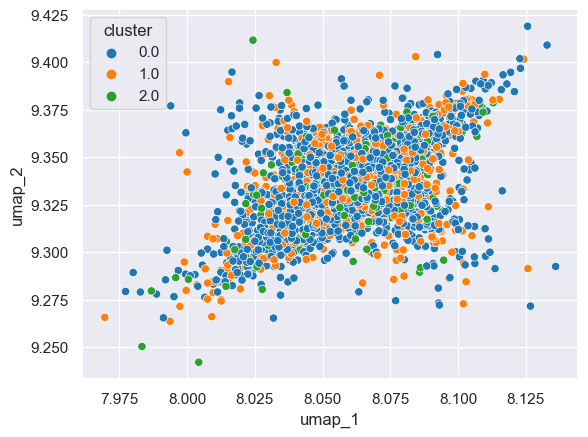

In [403]:
sns.scatterplot(data = birch_umap_df, x = 'umap_1', y='umap_2', hue = 'cluster', palette = 'tab10');

### Baseline Birch Clustering with PCA

In [404]:
pca_birch_df = rec_df.copy()

In [405]:
pca_birch_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [406]:
birch_pca_cluster_pipeline = Pipeline([('scaler', StandardScaler()),
                                        ('pca', PCA(n_components=9)),
                                        ('model', Birch())])

In [407]:
pca_birch_preds = birch_pca_cluster_pipeline.fit_predict(pca_birch_df.select_dtypes(np.number))

In [408]:
pca_birch_preds

array([1, 2, 0, ..., 1, 1, 0], dtype=int64)

In [409]:
birch_pca_cluster_pipeline['pca'].components_

array([[-0.15024599,  0.06472382, -0.62318258, -0.04052279, -0.59864311,
         0.11889898, -0.26627048,  0.13958413, -0.16639778, -0.03695767,
        -0.22428204, -0.02857896, -0.20042663],
       [-0.24426559, -0.61234131,  0.10952141,  0.01973029, -0.0391188 ,
        -0.0350763 , -0.00411959,  0.39941951,  0.08316468, -0.50924764,
         0.16689922,  0.25491224, -0.17773449],
       [ 0.40162771,  0.07881235, -0.1011505 ,  0.30852383, -0.06181144,
        -0.36924105,  0.19415123, -0.20094982, -0.07538435, -0.3538427 ,
        -0.39818197,  0.46558627,  0.05121881],
       [ 0.29846024, -0.11955139, -0.08939126, -0.40817727, -0.07770734,
         0.42499458,  0.26805794, -0.39518958,  0.40139245, -0.22698923,
        -0.02753222, -0.03940501, -0.30395722],
       [-0.26416704,  0.02985767, -0.08584518,  0.38425409, -0.14224333,
        -0.34511436,  0.4309836 ,  0.02198419,  0.47350792,  0.06926875,
        -0.05624375, -0.40729778, -0.22510819],
       [ 0.36381394, -0.151424

In [410]:
birch_pca_cluster_pipeline['pca'].explained_variance_ratio_

array([0.15472216, 0.14072337, 0.0965703 , 0.08836944, 0.08412183,
       0.07647209, 0.06807298, 0.0671418 , 0.06324534])

In [411]:
pca_birch_df['cluster_label'] = pca_birch_preds

In [412]:
pca_birch_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,2
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,0
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,1
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,1
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1


In [413]:
projection_birch_pca = PCA_pipeline(StandardScaler(), pca_birch_df)

In [414]:
projection_birch_pca

,x,y,artist,title,cluster
0,-0.361019,-0.589846,Bon Jovi,Livin' On A Prayer,1.0
1,-1.715813,1.739846,Bon Jovi,Wanted Dead Or Alive,2.0
2,1.464023,0.619463,Queen,We Are The Champions - Remastered 2011,0.0
3,1.216051,-1.632365,Queen,We Will Rock You - Remastered 2011,1.0
4,-1.398913,-0.690478,Bon Jovi,You Give Love A Bad Name,2.0
...,...,...,...,...,...
6508,0.087099,-2.215024,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,1.0
6509,1.450402,-1.979275,N.W.A.,Gangsta Gangsta,1.0
6510,-0.639250,-2.270481,Various Artists,Rollin' With My Homies,1.0
6511,-0.710774,-2.493815,Nas,N.Y. State of Mind,1.0


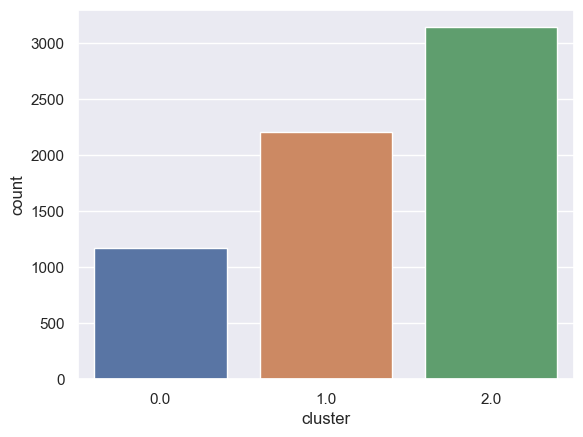

In [415]:
sns.countplot(data=projection_birch_pca, x = 'cluster');

In [416]:
projection_birch_pca['cluster'].value_counts()

2.0    3138
1.0    2208
0.0    1166
Name: cluster, dtype: int64

In [417]:
plot_clusters(projection_birch_pca, 'x', 'y')

In [418]:
clustering_metrics(pca_birch_df.select_dtypes(np.number).drop('cluster_label', axis=1), pca_birch_preds)

Silhouette Score:  -0.04414056710422598 

 -------------------------- 


Calinski Harabasz Score:  125.00826067917471  

 -------------------------- 


Davies Bouldin Score:  15.422346271194343 

 -------------------------- 




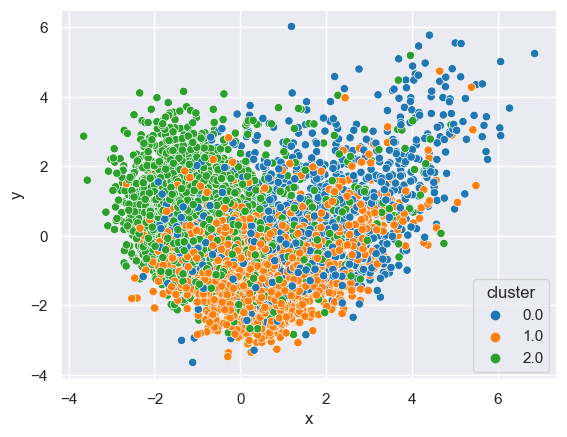

In [419]:
sns.scatterplot(data = projection_birch_pca, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Gridsearch Birch Clustering with UMAP

In [420]:
gs_birch_umap_df = rec_df.copy().select_dtypes(np.number)

In [421]:
gs_birch_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [422]:
birch_pipe_gs_umap = Pipeline(steps = [('scaler', StandardScaler()),
                                    ('umap', umap.UMAP()),
                                    ('model', Birch())])


In [423]:
birch_umap_grid = {'umap__n_neighbors':[2, 50, 100],
                    'umap__min_dist':[0.5, 0.8],
                    'model__n_clusters': [7, 20, 57, 80, 107],
                    'model__threshold':[0.01, 0.1, 0.5, 0.8],
                        }


In [424]:
birch_gs_umap = GridSearchCV(estimator= birch_pipe_gs_umap, 
                              param_grid = birch_umap_grid, 
                              scoring = cv_silhouette_scorer,
                             cv=cv)

In [425]:
birch_gs_umap.fit(gs_birch_umap_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_birch.py:752: ConvergenceWarning:

Number of subclusters found (45) by BIRCH is less than (80). Decrease the threshold.

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_birch.py:752: ConvergenceWarning:

Number of subclusters found (35) by BIRCH is less than (80). Decrease the threshold.

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_birch.py:752: ConvergenceWarning:

Number of subclusters found (34) by BIRCH is less than (80). Decrease the threshold.

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is lik

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_birch.py:752: ConvergenceWarning:

Number of subclusters found (40) by BIRCH is less than (107). Decrease the threshold.

C:\Users\Jonathan\anaconda3\envs\recom

GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('umap', UMAP()), ('model', Birch())]),
             param_grid={'model__n_clusters': [7, 20, 57, 80, 107],
                         'model__threshold': [0.01, 0.1, 0.5, 0.8],
                         'umap__min_dist': [0.5, 0.8],
                         'umap__n_neighbors': [2, 50, 100]},
             scoring=<function cv_silhouette_scorer at 0x000001B9823430A0>)

In [426]:
birch_gs_umap.best_params_

{'model__n_clusters': 7,
 'model__threshold': 0.5,
 'umap__min_dist': 0.8,
 'umap__n_neighbors': 2}

In [427]:
birch_gs_umap.best_score_

-0.051977501986318474

In [428]:
birch_gs_umap.scorer_

<function __main__.cv_silhouette_scorer(estimator, X)>

In [429]:
preds_birch_umap = birch_gs_umap.predict(gs_birch_umap_df)

In [430]:
preds_birch_umap

array([2, 0, 3, ..., 5, 2, 2], dtype=int64)

In [431]:
gs_birch_umap_df['cluster'] = preds_birch_umap

In [432]:
gs_birch_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,2
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,0
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,3
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,1
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,5
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,2


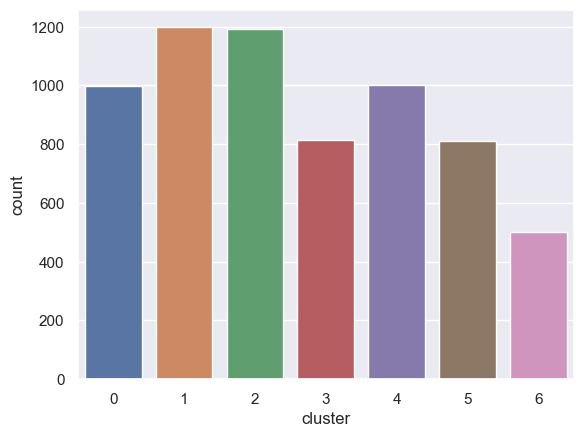

In [433]:
sns.countplot(data=gs_birch_umap_df, x = 'cluster');

In [434]:
gs_birch_umap_df['cluster'].value_counts()

1    1198
2    1192
4    1000
0     997
3     815
5     811
6     500
Name: cluster, dtype: int64

In [435]:
birch_gs_umap_db = birch_gs_umap.best_estimator_.named_steps['umap'].transform(gs_birch_umap_df.drop('cluster', axis=1))

In [436]:
birch_gs_umap_df = pd.DataFrame(birch_gs_umap_db, columns=['umap_1', 'umap_2'])

In [437]:
birch_gs_umap_df.isna().sum()

umap_1    0
umap_2    0
dtype: int64

In [438]:
birch_gs_umap_df['cluster'] = gs_birch_umap_df['cluster']

In [439]:
birch_gs_umap_df

,umap_1,umap_2,cluster
0,-14.345225,-2.609578,2.0
1,-14.454314,-2.176072,0.0
2,-14.125603,-2.012037,3.0
3,-14.432065,-2.237263,4.0
4,-14.115891,-2.075939,0.0
...,...,...,...
6508,-14.213561,-2.417649,1.0
6509,-14.377139,-2.436496,1.0
6510,-14.379643,-2.164246,1.0
6511,-14.426251,-2.112916,5.0


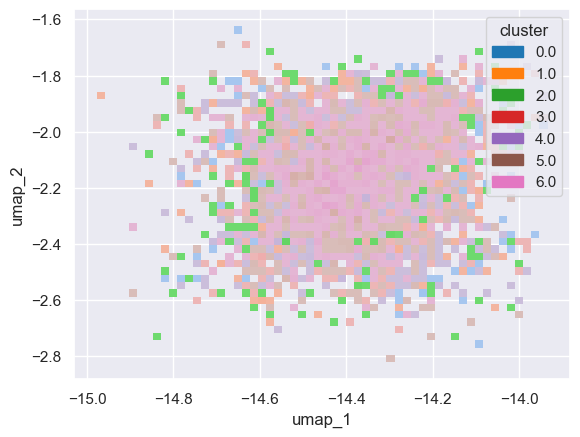

In [440]:
sns.histplot(x = 'umap_1', y = 'umap_2', data = birch_gs_umap_df, hue = 'cluster', palette = 'tab10');

In [441]:
px.scatter(birch_gs_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

### Gridsearch Birch Clustering with PCA

In [443]:
gs_birch_pca_df = rec_df.copy().select_dtypes(np.number)

In [444]:
gs_birch_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [445]:
birch_pipe_gs_pca = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('pca', PCA()),
                                        ('model', Birch())])

In [452]:
birch_pca_grid = {'pca__n_components':[9, 11, 13, 'mle'],
                    'model__n_clusters': [7, 20, 57, 80, 107],
                    'model__threshold':[0.01, 0.1, 0.5, 0.8]
                  }


In [453]:
birch_gs_pca = GridSearchCV(estimator=birch_pipe_gs_pca,
                             param_grid = birch_pca_grid,
                             scoring = cv_silhouette_scorer,
                             cv=cv)

In [454]:
birch_gs_pca.fit(gs_birch_pca_df)

GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('pca', PCA()), ('model', Birch())]),
             param_grid={'model__n_clusters': [7, 20, 57, 80, 107],
                         'model__threshold': [0.01, 0.1, 0.5, 0.8],
                         'pca__n_components': [9, 11, 13, 'mle']},
             scoring=<function cv_silhouette_scorer at 0x000001B9823430A0>)

In [455]:
birch_pca_preds = birch_gs_pca.predict(gs_birch_pca_df)

In [456]:
gs_birch_pca_df['cluster'] = birch_pca_preds

In [457]:
gs_birch_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,1
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,3
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,5
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,5
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,2
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,5
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,5


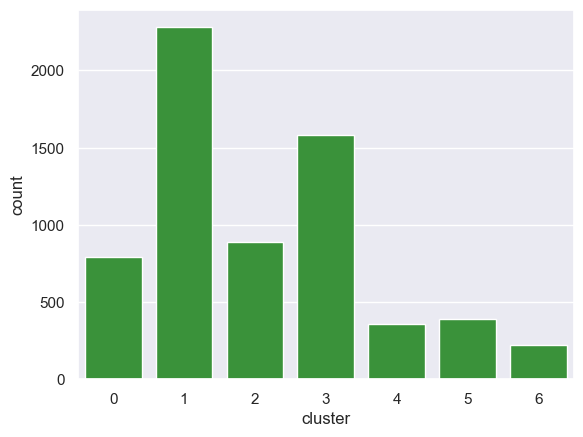

In [458]:
sns.countplot(data=gs_birch_pca_df, x = 'cluster', orient = "h", color = 'tab:green');

In [459]:
clustering_metrics(gs_birch_pca_df.drop('cluster', axis=1), birch_pca_preds)

Silhouette Score:  -0.08052380282769846 

 -------------------------- 


Calinski Harabasz Score:  86.34183358619052  

 -------------------------- 


Davies Bouldin Score:  63.751815394798484 

 -------------------------- 




In [460]:
birch_gs_pca.best_params_

{'model__n_clusters': 7, 'model__threshold': 0.1, 'pca__n_components': 13}

In [461]:
birch_gs_pca.best_score_

-0.08052380282769846

In [462]:
birch_gs_pca.scorer_

<function __main__.cv_silhouette_scorer(estimator, X)>

In [464]:
birch_pca_pipeline = Pipeline([('scaler', StandardScaler()), 
                            ('PCA', PCA(n_components=2))])

songs_birch_pca = gs_birch_pca_df 
song_embedding_birch_pca = birch_pca_pipeline.fit_transform(songs_birch_pca)
projection_birch_pca = pd.DataFrame(columns=['x', 'y'], data=song_embedding_birch_pca)

projection_birch_pca['artist'] = rec_df['artist']
projection_birch_pca['title'] = rec_df['track_name']
projection_birch_pca['cluster'] = gs_birch_pca_df['cluster']

In [465]:
projection_birch_pca

,x,y,artist,title,cluster
0,-0.486489,0.692836,Bon Jovi,Livin' On A Prayer,1.0
1,-0.279143,2.295927,Bon Jovi,Wanted Dead Or Alive,1.0
2,0.601943,-0.622994,Queen,We Are The Champions - Remastered 2011,3.0
3,-0.195846,-2.715875,Queen,We Will Rock You - Remastered 2011,5.0
4,-1.265731,-0.351633,Bon Jovi,You Give Love A Bad Name,3.0
...,...,...,...,...,...
6508,-1.898804,-3.219794,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,2.0
6509,0.537197,-1.614047,N.W.A.,Gangsta Gangsta,5.0
6510,-2.465294,-2.441075,Various Artists,Rollin' With My Homies,2.0
6511,-2.774880,-2.754112,Nas,N.Y. State of Mind,5.0


In [466]:
plot_clusters(projection_birch_pca, 'x', 'y')

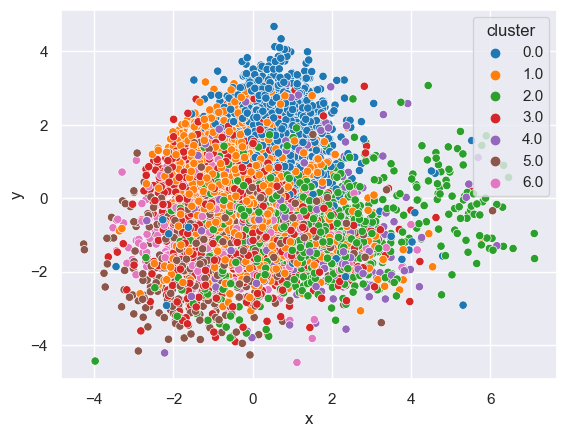

In [467]:
sns.scatterplot(data = projection_birch_pca, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

#### Using MiniBatchKMeans

## <u>MiniBatchKMeans<u/>

### Baseline MiniBatchKMeans with no dimensionality reduction

In [468]:
#Setting up pipeline to scale data and perform kmeans on the data
mbkmeans_base_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                                 ('model', MiniBatchKMeans())])

In [469]:
#Creating a copy DataFrame for modeling
mbkmeans_base_song_df = rec_df.select_dtypes(np.number)
mbkmeans_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [470]:
#Predicting clusters based on the DataFrame
mbkmeans_song_base_labels = mbkmeans_base_cluster_pipeline.fit_predict(mbkmeans_base_song_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4



In [471]:
#Adding cluster outputs, artist and track names to the DataFrame
mbkmeans_base_song_df['cluster_label'] = mbkmeans_song_base_labels
mbkmeans_base_song_df['artist'] = rec_df['artist']
mbkmeans_base_song_df['track_name'] = rec_df['track_name']

In [472]:
#Checking columns
mbkmeans_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label,artist,track_name
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,6,Bon Jovi,Livin' On A Prayer
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,4,Bon Jovi,Wanted Dead Or Alive
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,7,Queen,We Are The Champions - Remastered 2011
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,6,Queen,We Will Rock You - Remastered 2011
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,6,Bon Jovi,You Give Love A Bad Name
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1,N.W.A.,Gangsta Gangsta
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,6,Various Artists,Rollin' With My Homies
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1,Nas,N.Y. State of Mind
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1,Nas,Nas Is Like


In [473]:
#Checking unsupervised learning metrics
clustering_metrics(mbkmeans_base_song_df.select_dtypes(np.number).drop('cluster_label', axis=1), mbkmeans_song_base_labels)

Silhouette Score:  -0.13613725501758916 

 -------------------------- 


Calinski Harabasz Score:  32.653951351875754  

 -------------------------- 


Davies Bouldin Score:  60.79077107572841 

 -------------------------- 




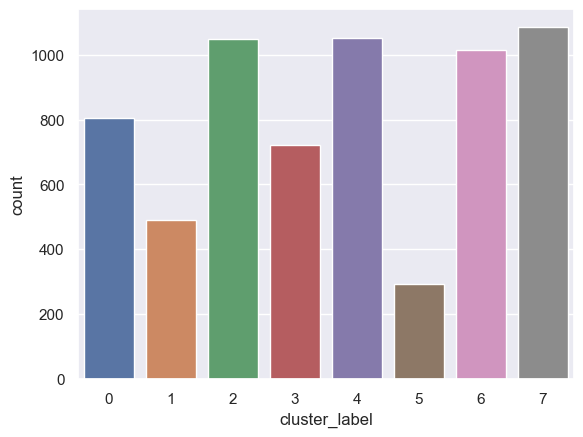

In [474]:
#Visualizing counts of songs assigned to each cluster
sns.countplot(data=mbkmeans_base_song_df, x = 'cluster_label');

In [475]:
#Checking how many songs are assigned to each cluster
mbkmeans_base_song_df['cluster_label'].value_counts()

7    1086
4    1052
2    1048
6    1016
0     805
3     722
1     491
5     293
Name: cluster_label, dtype: int64

In [476]:
#Scaling and transforming data using PCA into 2 dimensions for visualization
projection_mbkmeans_base = PCA_pipeline(StandardScaler(), mbkmeans_base_song_df)

In [477]:
#Visualizing points based on PCA dimensions along with song titles with plotly
plot_clusters(projection_mbkmeans_base, 'x', 'y')

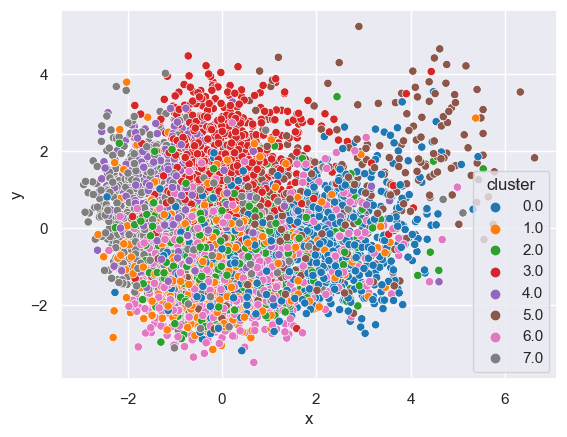

In [478]:
#Visualizing points based on PCA dimensions with seaborn
sns.scatterplot(data = projection_mbkmeans_base, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Baseline MiniBatchKMeans with UMAP

In [479]:
mbkmeans_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('umap', umap.UMAP()),
                                        ('model', MiniBatchKMeans())])

In [480]:
mbkmeans_umap_song_df = rec_df.select_dtypes(np.number)
mbkmeans_umap_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [481]:
mbkmeans_umap_song_cluster_labels = mbkmeans_cluster_pipeline.fit_predict(mbkmeans_umap_song_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4



In [482]:
mbkmeans_umap_song_df['cluster_label'] = mbkmeans_umap_song_cluster_labels

In [483]:
mbkmeans_umap_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,0
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,3
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,0
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,3
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,0
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,0


In [484]:
clustering_metrics(mbkmeans_umap_song_df.drop('cluster_label', axis=1), mbkmeans_umap_song_cluster_labels)

Silhouette Score:  -0.12465469986579757 

 -------------------------- 


Calinski Harabasz Score:  57.642624820989795  

 -------------------------- 


Davies Bouldin Score:  41.955022833456454 

 -------------------------- 




In [485]:
mbkmeans_umap_db = mbkmeans_cluster_pipeline['umap'].transform(rec_df.select_dtypes(np.number))

In [486]:
mbkmeans_umap_df = pd.DataFrame(mbkmeans_umap_db, columns=['umap_1', 'umap_2'])

In [487]:
mbkmeans_umap_df['cluster'] = mbkmeans_umap_song_df['cluster_label']

In [488]:
mbkmeans_umap_df

,umap_1,umap_2,cluster
0,12.864859,14.279893,4.0
1,12.864630,14.274288,4.0
2,12.890758,14.287089,0.0
3,12.865532,14.282337,3.0
4,12.904303,14.276400,0.0
...,...,...,...
6508,12.857760,14.277879,3.0
6509,12.874931,14.296399,0.0
6510,12.847937,14.290770,3.0
6511,12.876010,14.275324,0.0


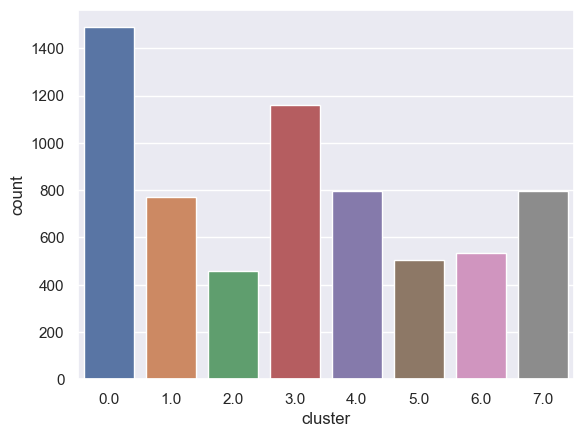

In [489]:
sns.countplot(data=mbkmeans_umap_df, x = 'cluster');

In [490]:
mbkmeans_umap_df['cluster'].value_counts()

0.0    1489
3.0    1158
4.0     798
7.0     796
1.0     770
6.0     535
5.0     506
2.0     460
Name: cluster, dtype: int64

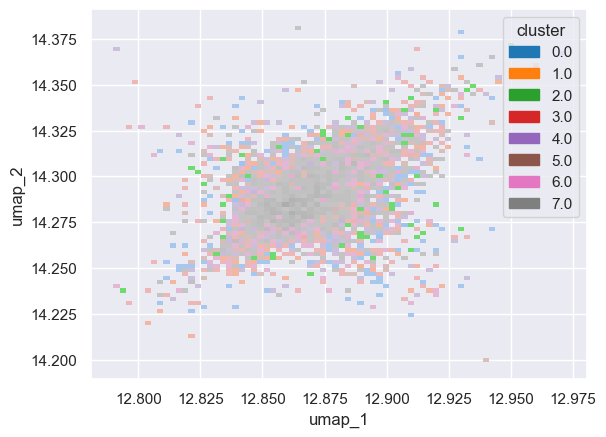

In [491]:
sns.histplot(x = 'umap_1', y = 'umap_2', data = mbkmeans_umap_df, hue = 'cluster', palette = 'tab10');

In [492]:
px.scatter(mbkmeans_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

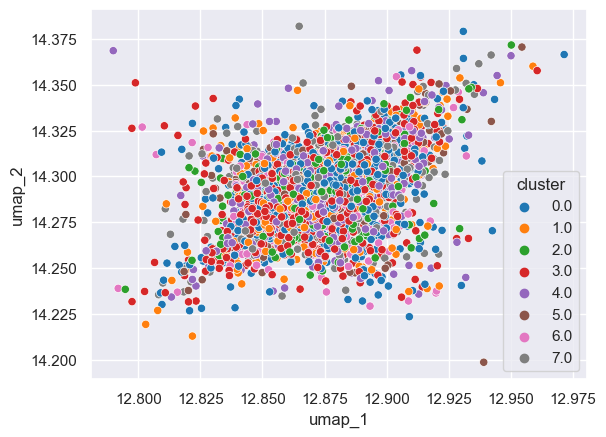

In [493]:
sns.scatterplot(data = mbkmeans_umap_df, x = 'umap_1', y='umap_2', hue = 'cluster', palette = 'tab10');

### Baseline MiniBatchKMeans with PCA

In [494]:
pca_mbkmeans_df = rec_df.copy()

In [495]:
pca_mbkmeans_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [496]:
mbkmeans_pca_cluster_pipeline = Pipeline([('scaler', StandardScaler()),
                                        ('pca', PCA(n_components=9)),
                                        ('model', MiniBatchKMeans())])

In [497]:
pca_mbkmeans_preds = mbkmeans_pca_cluster_pipeline.fit_predict(pca_mbkmeans_df.select_dtypes(np.number))

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4



In [498]:
pca_mbkmeans_preds

array([5, 1, 7, ..., 0, 0, 3])

In [499]:
mbkmeans_pca_cluster_pipeline['pca'].components_

array([[-0.15024599,  0.06472382, -0.62318258, -0.04052279, -0.59864311,
         0.11889898, -0.26627048,  0.13958413, -0.16639778, -0.03695767,
        -0.22428204, -0.02857896, -0.20042663],
       [-0.24426559, -0.61234131,  0.10952141,  0.01973029, -0.0391188 ,
        -0.0350763 , -0.00411959,  0.39941951,  0.08316468, -0.50924764,
         0.16689922,  0.25491224, -0.17773449],
       [ 0.40162771,  0.07881235, -0.1011505 ,  0.30852383, -0.06181144,
        -0.36924105,  0.19415123, -0.20094982, -0.07538435, -0.3538427 ,
        -0.39818197,  0.46558627,  0.05121881],
       [ 0.29846024, -0.11955139, -0.08939126, -0.40817727, -0.07770734,
         0.42499458,  0.26805794, -0.39518958,  0.40139245, -0.22698923,
        -0.02753222, -0.03940501, -0.30395722],
       [-0.26416704,  0.02985767, -0.08584518,  0.38425409, -0.14224333,
        -0.34511436,  0.4309836 ,  0.02198419,  0.47350792,  0.06926875,
        -0.05624375, -0.40729778, -0.22510819],
       [ 0.36381394, -0.151424

In [500]:
mbkmeans_pca_cluster_pipeline['pca'].explained_variance_ratio_

array([0.15472216, 0.14072337, 0.0965703 , 0.08836944, 0.08412183,
       0.07647209, 0.06807298, 0.0671418 , 0.06324534])

In [501]:
pca_mbkmeans_df['cluster_label'] = pca_mbkmeans_preds

In [502]:
pca_mbkmeans_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,5
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,1
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,7
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,5
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,0
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,5
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,0
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,0


In [503]:
projection_mbkmeans_pca = PCA_pipeline(StandardScaler(), pca_mbkmeans_df)

In [504]:
projection_mbkmeans_pca

,x,y,artist,title,cluster
0,-0.633156,0.011902,Bon Jovi,Livin' On A Prayer,5.0
1,-0.763344,1.881828,Bon Jovi,Wanted Dead Or Alive,1.0
2,1.000523,0.820318,Queen,We Are The Champions - Remastered 2011,7.0
3,0.500034,-1.617292,Queen,We Will Rock You - Remastered 2011,5.0
4,-1.248109,-0.586259,Bon Jovi,You Give Love A Bad Name,0.0
...,...,...,...,...,...
6508,-1.159767,-2.098175,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,5.0
6509,0.755549,-2.105676,N.W.A.,Gangsta Gangsta,0.0
6510,-1.920622,-1.848395,Various Artists,Rollin' With My Homies,5.0
6511,-2.189182,-2.134179,Nas,N.Y. State of Mind,0.0


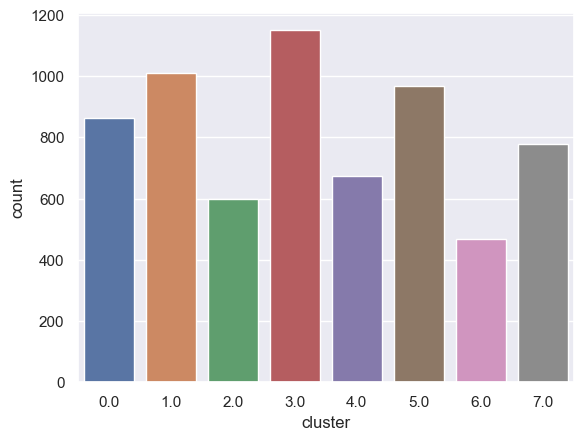

In [505]:
sns.countplot(data=projection_mbkmeans_pca, x = 'cluster');

In [506]:
projection_mbkmeans_pca['cluster'].value_counts()

3.0    1150
1.0    1011
5.0     968
0.0     863
7.0     779
4.0     673
2.0     600
6.0     468
Name: cluster, dtype: int64

In [507]:
plot_clusters(projection_mbkmeans_pca, 'x', 'y')

In [509]:
clustering_metrics(projection_mbkmeans_pca.select_dtypes(np.number).drop('cluster', axis=1), pca_mbkmeans_preds)

Silhouette Score:  0.006205103266149624 

 -------------------------- 


Calinski Harabasz Score:  1400.284052990875  

 -------------------------- 


Davies Bouldin Score:  2.478328216249553 

 -------------------------- 




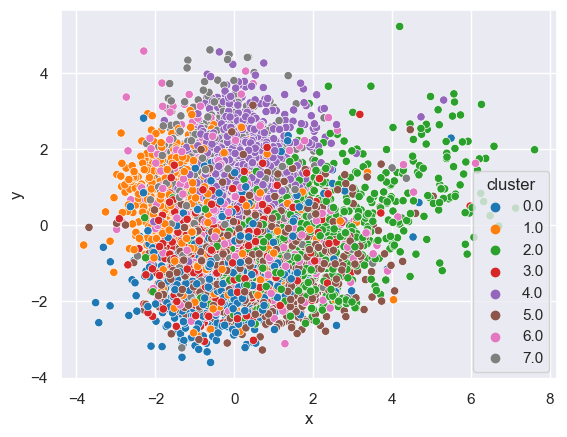

In [510]:
sns.scatterplot(data = projection_mbkmeans_pca, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Gridsearch MiniBatchKMeans with UMAP

In [511]:
gs_mbkmeans_umap_df = rec_df.copy().select_dtypes(np.number)

In [512]:
gs_mbkmeans_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [513]:
mbkmeans_pipe_gs_umap = Pipeline(steps = [('scaler', StandardScaler()),
                                    ('umap', umap.UMAP()),
                                    ('model', MiniBatchKMeans())])


In [514]:
mbkmeans_umap_grid = {'umap__n_neighbors':[2, 50, 100],
                    'umap__min_dist':[0.5, 0.8],
                    'model__n_clusters': [7, 20, 57, 80, 107],
                    'model__max_iter':[100, 500, 1000],
                      'model__batch_size':[512, 1024, 2048]
                        }


In [515]:
mbkmeans_gs_umap = GridSearchCV(estimator= mbkmeans_pipe_gs_umap, 
                              param_grid = mbkmeans_umap_grid, 
                              scoring = cv_silhouette_scorer,
                             cv=cv)

In [517]:
mbkmeans_gs_umap.fit(gs_mbkmeans_umap_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigeng

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigeng

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigeng

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a mem

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a mem

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigeng

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigeng

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can pre

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a mem

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can pre

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a mem

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can pre

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigeng

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-pa

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4



GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('umap', UMAP()),
                                       ('model', MiniBatchKMeans())]),
             param_grid={'model__batch_size': [512, 1024, 2048],
                         'model__max_iter': [100, 500, 1000, 0.8],
                         'model__n_clusters': [7, 20, 57, 80, 107],
                         'umap__min_dist': [0.5, 0.8],
                         'umap__n_neighbors': [2, 50, 100]},
             scoring=<function cv_silhouette_scorer at 0x000001B9823430A0>)

In [518]:
mbkmeans_gs_umap.best_params_

{'model__batch_size': 1024,
 'model__max_iter': 100,
 'model__n_clusters': 7,
 'umap__min_dist': 0.8,
 'umap__n_neighbors': 2}

In [519]:
mbkmeans_gs_umap.best_score_

-0.047600011869412207

In [520]:
mbkmeans_gs_umap.scorer_

<function __main__.cv_silhouette_scorer(estimator, X)>

In [521]:
preds_mbkmeans_umap = mbkmeans_gs_umap.predict(gs_mbkmeans_umap_df)

In [522]:
preds_mbkmeans_umap

array([2, 6, 4, ..., 3, 2, 5])

In [523]:
gs_mbkmeans_umap_df['cluster'] = preds_mbkmeans_umap

In [524]:
gs_mbkmeans_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,2
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,6
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,5
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,1
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,3
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,2


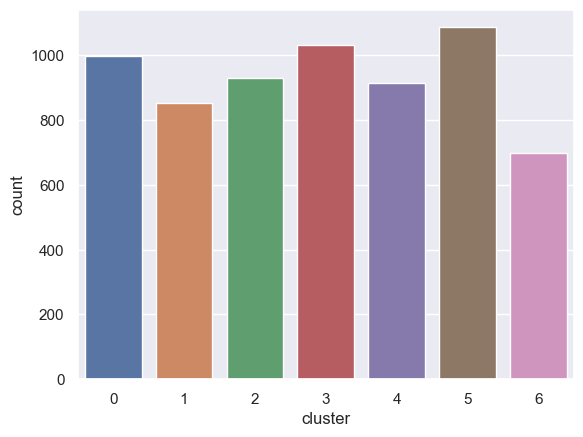

In [525]:
sns.countplot(data=gs_mbkmeans_umap_df, x = 'cluster');

In [526]:
gs_mbkmeans_umap_df['cluster'].value_counts()

5    1087
3    1031
0     997
2     930
4     915
1     853
6     700
Name: cluster, dtype: int64

In [527]:
mbkmeans_gs_umap_db = mbkmeans_gs_umap.best_estimator_.named_steps['umap'].transform(gs_mbkmeans_umap_df.drop('cluster', axis=1))

In [528]:
mbkmeans_gs_umap_df = pd.DataFrame(mbkmeans_gs_umap_db, columns=['umap_1', 'umap_2'])

In [529]:
mbkmeans_gs_umap_df.isna().sum()

umap_1    0
umap_2    0
dtype: int64

In [530]:
mbkmeans_gs_umap_df['cluster'] = gs_mbkmeans_umap_df['cluster']

In [531]:
mbkmeans_gs_umap_df

,umap_1,umap_2,cluster
0,13.625507,10.397938,2.0
1,13.391458,10.500827,6.0
2,13.365844,10.517727,4.0
3,13.262637,10.461907,5.0
4,13.563069,10.451677,3.0
...,...,...,...
6508,13.426181,10.330352,2.0
6509,13.405837,10.394719,1.0
6510,13.800408,10.390229,1.0
6511,13.474483,10.382401,3.0


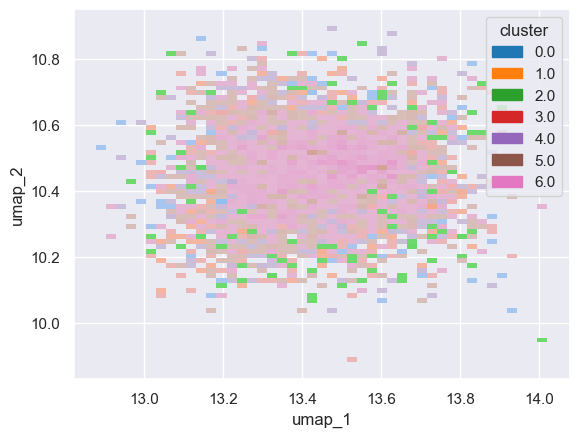

In [532]:
sns.histplot(x = 'umap_1', y = 'umap_2', data = mbkmeans_gs_umap_df, hue = 'cluster', palette = 'tab10');

In [533]:
px.scatter(mbkmeans_gs_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

### Gridsearch MiniBatchKMeans with PCA

In [534]:
gs_mbkmeans_pca_df = rec_df.copy().select_dtypes(np.number)

In [535]:
gs_mbkmeans_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [536]:
mbkmeans_pipe_gs_pca = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('pca', PCA()),
                                        ('model', MiniBatchKMeans())])

In [537]:
mbkmeans_pca_grid = {'pca__n_components':[9, 11, 13, 'mle'],
                    'model__n_clusters': [7, 20, 57, 80, 107],
                    'model__max_iter':[100, 500, 1000, 0.8],
                      'model__batch_size':[512, 1024, 2048]
                  }


In [538]:
mbkmeans_gs_pca = GridSearchCV(estimator=mbkmeans_pipe_gs_pca,
                             param_grid = mbkmeans_pca_grid,
                             scoring = cv_silhouette_scorer,
                             cv=cv)

In [539]:
mbkmeans_gs_pca.fit(gs_mbkmeans_pca_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=2

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=8

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment

GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('pca', PCA()),
                                       ('model', MiniBatchKMeans())]),
             param_grid={'model__batch_size': [512, 1024, 2048],
                         'model__max_iter': [100, 500, 1000, 0.8],
                         'model__n_clusters': [7, 20, 57, 80, 107],
                         'pca__n_components': [9, 11, 13, 'mle']},
             scoring=<function cv_silhouette_scorer at 0x000001B9823430A0>)

In [540]:
mbkmeans_pca_preds = mbkmeans_gs_pca.predict(gs_mbkmeans_pca_df)

In [541]:
gs_mbkmeans_pca_df['cluster'] = mbkmeans_pca_preds

In [542]:
gs_mbkmeans_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,0
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,5
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,0
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,3
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,0
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,2


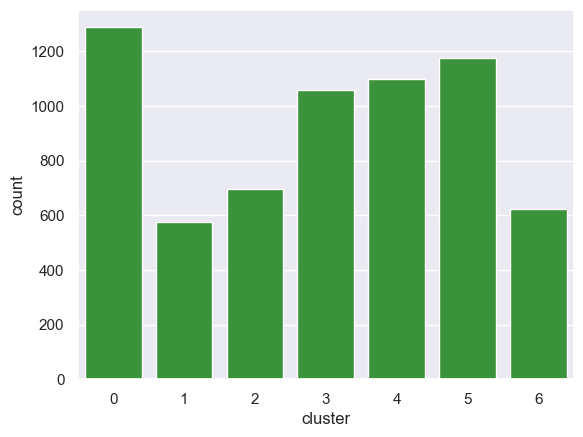

In [543]:
sns.countplot(data=gs_mbkmeans_pca_df, x = 'cluster', orient = "h", color = 'tab:green');

In [544]:
clustering_metrics(gs_mbkmeans_pca_df.drop('cluster', axis=1), mbkmeans_pca_preds)

Silhouette Score:  -0.15143047481140884 

 -------------------------- 


Calinski Harabasz Score:  135.85755407648566  

 -------------------------- 


Davies Bouldin Score:  13.330758679359247 

 -------------------------- 




In [545]:
mbkmeans_gs_pca.best_params_

{'model__batch_size': 2048,
 'model__max_iter': 500,
 'model__n_clusters': 7,
 'pca__n_components': 'mle'}

In [546]:
mbkmeans_gs_pca.best_score_

-0.06833274993077507

In [547]:
mbkmeans_gs_pca.scorer_

<function __main__.cv_silhouette_scorer(estimator, X)>

In [548]:
mbkmeans_pca_pipeline = Pipeline([('scaler', StandardScaler()), 
                            ('PCA', PCA(n_components=2))])

songs_mbkmeans_pca = gs_mbkmeans_pca_df 
song_embedding_mbkmeans_pca = mbkmeans_pca_pipeline.fit_transform(songs_mbkmeans_pca)
projection_mbkmeans_pca = pd.DataFrame(columns=['x', 'y'], data=song_embedding_mbkmeans_pca)

projection_mbkmeans_pca['artist'] = rec_df['artist']
projection_mbkmeans_pca['title'] = rec_df['track_name']
projection_mbkmeans_pca['cluster'] = gs_mbkmeans_pca_df['cluster']

In [549]:
projection_mbkmeans_pca

,x,y,artist,title,cluster
0,-0.391160,-0.975847,Bon Jovi,Livin' On A Prayer,0.0
1,2.406201,0.791626,Bon Jovi,Wanted Dead Or Alive,5.0
2,0.037700,1.002050,Queen,We Are The Champions - Remastered 2011,4.0
3,-2.242262,-0.944406,Queen,We Will Rock You - Remastered 2011,0.0
4,0.849321,-0.956616,Bon Jovi,You Give Love A Bad Name,4.0
...,...,...,...,...,...
6508,-0.349577,-1.764845,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,3.0
6509,-2.019963,-0.776866,N.W.A.,Gangsta Gangsta,4.0
6510,-0.747910,-2.591527,Various Artists,Rollin' With My Homies,3.0
6511,-0.278835,-2.693788,Nas,N.Y. State of Mind,0.0


In [550]:
plot_clusters(projection_mbkmeans_pca, 'x', 'y')

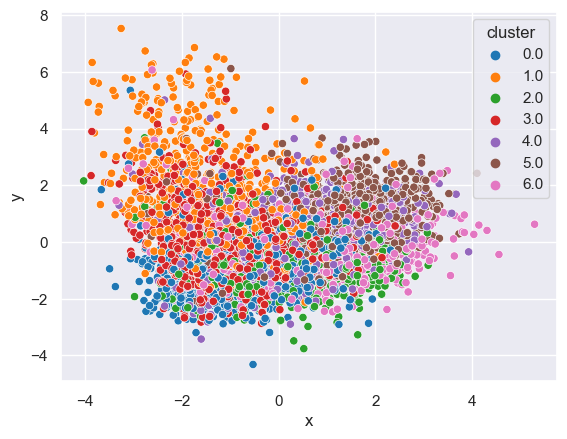

In [551]:
sns.scatterplot(data = projection_mbkmeans_pca, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

## <u>GaussianMixture<u/>

### Baseline GaussianMixture with no dimensionality reduction

In [662]:
#Setting up pipeline to scale data and perform kmeans on the data
gm_base_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                                 ('model', GaussianMixture(n_components=7))])

In [663]:
#Creating a copy DataFrame for modeling
gm_base_song_df = rec_df.select_dtypes(np.number)
gm_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [664]:
#Predicting clusters based on the DataFrame
gm_song_base_labels = gm_base_cluster_pipeline.fit_predict(gm_base_song_df)

In [665]:
#Adding cluster outputs, artist and track names to the DataFrame
gm_base_song_df['cluster_label'] = gm_song_base_labels
gm_base_song_df['artist'] = rec_df['artist']
gm_base_song_df['track_name'] = rec_df['track_name']

In [666]:
#Checking columns
gm_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label,artist,track_name
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,1,Bon Jovi,Livin' On A Prayer
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,2,Bon Jovi,Wanted Dead Or Alive
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,1,Queen,We Are The Champions - Remastered 2011
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,1,Queen,We Will Rock You - Remastered 2011
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1,Bon Jovi,You Give Love A Bad Name
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1,N.W.A.,Gangsta Gangsta
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,1,Various Artists,Rollin' With My Homies
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1,Nas,N.Y. State of Mind
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1,Nas,Nas Is Like


In [667]:
#Checking unsupervised learning metrics
clustering_metrics(gm_base_song_df.select_dtypes(np.number).drop('cluster_label', axis=1), gm_song_base_labels)

Silhouette Score:  -0.08395571644832024 

 -------------------------- 


Calinski Harabasz Score:  77.35627646900838  

 -------------------------- 


Davies Bouldin Score:  21.061062998089646 

 -------------------------- 




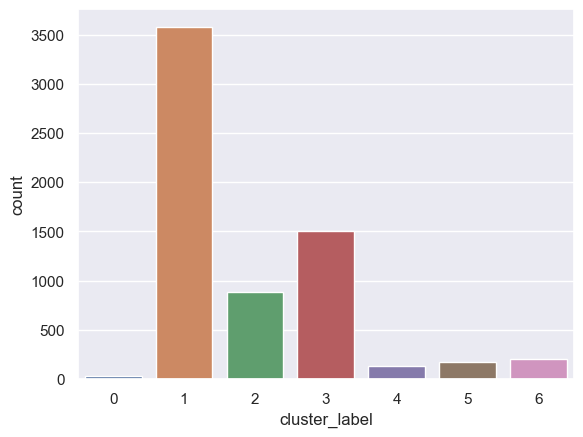

In [668]:
#Visualizing counts of songs assigned to each cluster
sns.countplot(data=gm_base_song_df, x = 'cluster_label');

In [669]:
#Checking how many songs are assigned to each cluster
gm_base_song_df['cluster_label'].value_counts()

1    3578
3    1509
2     885
6     203
5     173
4     133
0      32
Name: cluster_label, dtype: int64

In [670]:
#Scaling and transforming data using PCA into 2 dimensions for visualization
projection_gm_base = PCA_pipeline(StandardScaler(), gm_base_song_df)

In [671]:
#Visualizing points based on PCA dimensions along with song titles with plotly
plot_clusters(projection_gm_base, 'x', 'y')

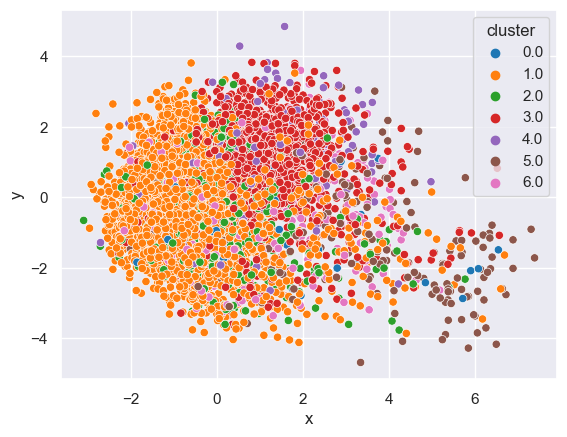

In [672]:
#Visualizing points based on PCA dimensions with seaborn
sns.scatterplot(data = projection_gm_base, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Baseline GaussianMixture with UMAP

In [631]:
gm_cluster_pipeline = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('umap', umap.UMAP()),
                                        ('model', GaussianMixture(n_components=7))])

In [632]:
gm_umap_song_df = rec_df.select_dtypes(np.number)
gm_umap_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [633]:
gm_umap_song_cluster_labels = gm_cluster_pipeline.fit_predict(gm_umap_song_df)

In [634]:
gm_umap_song_df['cluster_label'] = gm_umap_song_cluster_labels

In [635]:
gm_umap_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,0
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,0
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,1
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,6
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,6
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1


In [636]:
clustering_metrics(gm_umap_song_df.drop('cluster_label', axis=1), gm_umap_song_cluster_labels)

Silhouette Score:  -0.11747993429410196 

 -------------------------- 


Calinski Harabasz Score:  45.28017006172264  

 -------------------------- 


Davies Bouldin Score:  18.627050437637887 

 -------------------------- 




In [637]:
gm_umap_db = gm_cluster_pipeline['umap'].transform(rec_df.select_dtypes(np.number))

In [638]:
gm_umap_df = pd.DataFrame(gm_umap_db, columns=['umap_1', 'umap_2'])

In [639]:
gm_umap_df['cluster'] = gm_umap_song_df['cluster_label']

In [640]:
gm_umap_df

,umap_1,umap_2,cluster
0,12.348097,11.313025,0.0
1,12.348278,11.305225,0.0
2,12.364798,11.298828,1.0
3,12.350391,11.310532,6.0
4,12.362165,11.315289,1.0
...,...,...,...
6508,12.361447,11.307503,6.0
6509,12.362780,11.308295,1.0
6510,12.363965,11.312400,6.0
6511,12.341144,11.280746,1.0


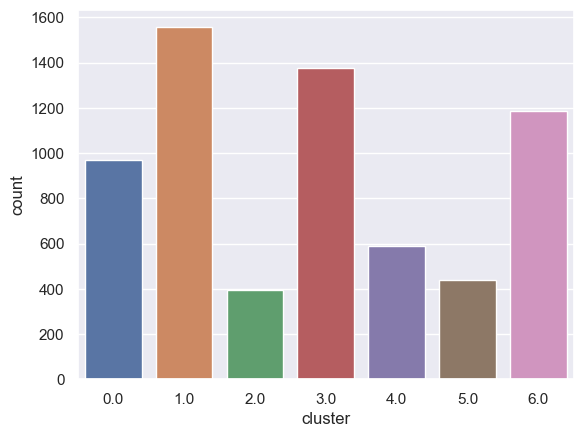

In [641]:
sns.countplot(data=gm_umap_df, x = 'cluster');

In [642]:
gm_umap_df['cluster'].value_counts()

1.0    1556
3.0    1377
6.0    1187
0.0     971
4.0     588
5.0     439
2.0     394
Name: cluster, dtype: int64

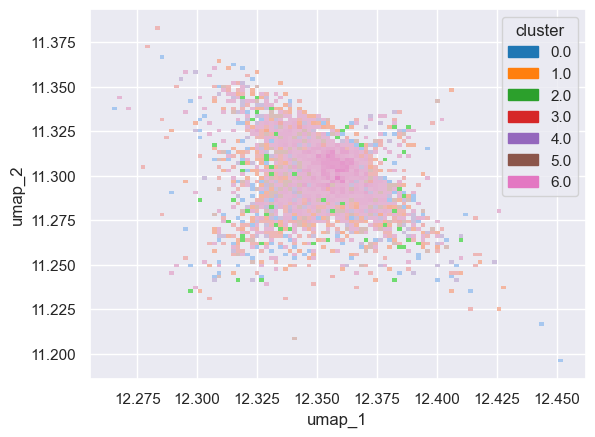

In [643]:
sns.histplot(x = 'umap_1', y = 'umap_2', data = gm_umap_df, hue = 'cluster', palette = 'tab10');

In [644]:
px.scatter(gm_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

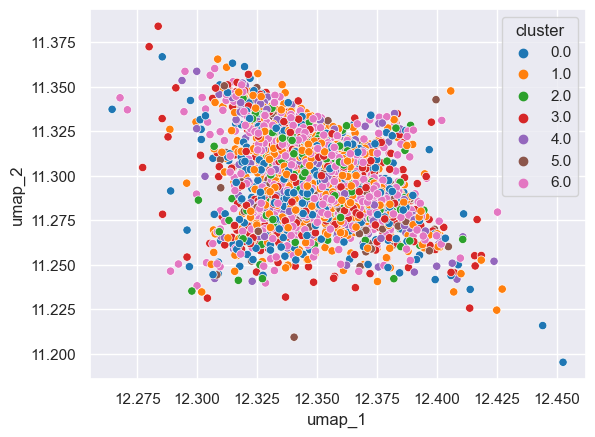

In [645]:
sns.scatterplot(data = gm_umap_df, x = 'umap_1', y='umap_2', hue = 'cluster', palette = 'tab10');

### Baseline GaussianMixture with PCA

In [646]:
pca_gm_df = rec_df.copy()

In [647]:
pca_gm_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [648]:
gm_pca_cluster_pipeline = Pipeline([('scaler', StandardScaler()),
                                        ('pca', PCA(n_components=9)),
                                        ('model', GaussianMixture(n_components=7))])

In [649]:
pca_gm_preds = gm_pca_cluster_pipeline.fit_predict(pca_gm_df.select_dtypes(np.number))

In [650]:
pca_gm_preds

array([6, 6, 0, ..., 0, 0, 6], dtype=int64)

In [651]:
gm_pca_cluster_pipeline['pca'].components_

array([[-0.15024599,  0.06472382, -0.62318258, -0.04052279, -0.59864311,
         0.11889898, -0.26627048,  0.13958413, -0.16639778, -0.03695767,
        -0.22428204, -0.02857896, -0.20042663],
       [-0.24426559, -0.61234131,  0.10952141,  0.01973029, -0.0391188 ,
        -0.0350763 , -0.00411959,  0.39941951,  0.08316468, -0.50924764,
         0.16689922,  0.25491224, -0.17773449],
       [ 0.40162771,  0.07881235, -0.1011505 ,  0.30852383, -0.06181144,
        -0.36924105,  0.19415123, -0.20094982, -0.07538435, -0.3538427 ,
        -0.39818197,  0.46558627,  0.05121881],
       [ 0.29846024, -0.11955139, -0.08939126, -0.40817727, -0.07770734,
         0.42499458,  0.26805794, -0.39518958,  0.40139245, -0.22698923,
        -0.02753222, -0.03940501, -0.30395722],
       [-0.26416704,  0.02985767, -0.08584518,  0.38425409, -0.14224333,
        -0.34511436,  0.4309836 ,  0.02198419,  0.47350792,  0.06926875,
        -0.05624375, -0.40729778, -0.22510819],
       [ 0.36381394, -0.151424

In [652]:
gm_pca_cluster_pipeline['pca'].explained_variance_ratio_

array([0.15472216, 0.14072337, 0.0965703 , 0.08836944, 0.08412183,
       0.07647209, 0.06807298, 0.0671418 , 0.06324534])

In [653]:
pca_gm_df['cluster_label'] = pca_gm_preds

In [654]:
pca_gm_df

,artist,artist_id,popularity,album,track_name,track_id,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster_label
0,Bon Jovi,58lV9VcRSjABbAbfWS6skp,8,Slippery When Wet,Livin' On A Prayer,0J6mQxEZnlRt9ymzFntA6z,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,6
1,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Bon Jovi Greatest Hits,Wanted Dead Or Alive,4Zj9VM4fO1KwkU3lFaECsW,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,6
2,Queen,1dfeR4HaWDbWqFHLkxsg1d,64,News Of The World (Deluxe Remastered Version),We Are The Champions - Remastered 2011,7ccI9cStQbQdystvc6TvxD,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,0
3,Queen,1dfeR4HaWDbWqFHLkxsg1d,69,News Of The World (Deluxe Remastered Version),We Will Rock You - Remastered 2011,54flyrjcdnQdco7300avMJ,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,5
4,Bon Jovi,58lV9VcRSjABbAbfWS6skp,0,Cross Road,You Give Love A Bad Name,7LBJui5MdjfCd8YZr4xaqA,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,N.W.A.,4EnEZVjo3w1cwcQYePccay,63,Straight Outta Compton,Gangsta Gangsta,1pOIpxfrQ8AszXZdKR3aH3,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,0
6510,Various Artists,3y24n3XhZ96wgwRXjvS17T,42,Clueless / Original Motion Picture Soundtrack,Rollin' With My Homies,3qTiTZJJDM3gZ8TFiMMr0j,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,6
6511,Nas,20qISvAhX20dpIbOOzGK3q,70,Illmatic,N.Y. State of Mind,0trHOzAhNpGCsGBEu7dOJo,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,0
6512,Nas,20qISvAhX20dpIbOOzGK3q,66,I Am...,Nas Is Like,3gY6tiCNsuVi6s8kPV6aQg,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,0


In [655]:
projection_gm_pca = PCA_pipeline(StandardScaler(), pca_gm_df)

In [656]:
projection_gm_pca

,x,y,artist,title,cluster
0,0.134923,-1.569548,Bon Jovi,Livin' On A Prayer,6.0
1,-0.537767,0.042554,Bon Jovi,Wanted Dead Or Alive,6.0
2,-0.391232,2.115186,Queen,We Are The Champions - Remastered 2011,0.0
3,1.075232,-1.216447,Queen,We Will Rock You - Remastered 2011,5.0
4,-1.582374,0.127374,Bon Jovi,You Give Love A Bad Name,0.0
...,...,...,...,...,...
6508,-1.660024,0.164651,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,6.0
6509,1.662962,-1.733471,N.W.A.,Gangsta Gangsta,0.0
6510,-2.233110,-0.299258,Various Artists,Rollin' With My Homies,6.0
6511,-2.551535,-0.224215,Nas,N.Y. State of Mind,0.0


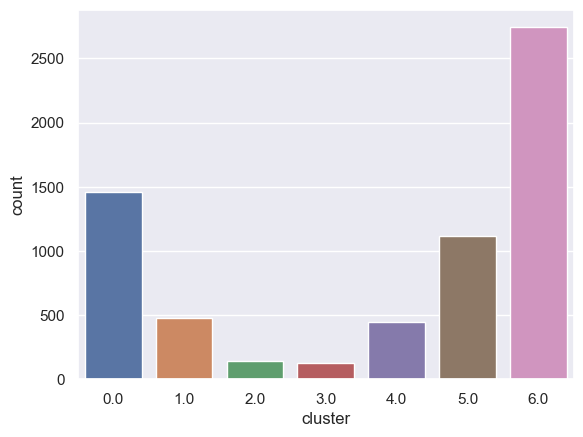

In [657]:
sns.countplot(data=projection_gm_pca, x = 'cluster');

In [658]:
projection_gm_pca['cluster'].value_counts()

6.0    2742
0.0    1459
5.0    1119
1.0     474
4.0     448
2.0     143
3.0     127
Name: cluster, dtype: int64

In [659]:
plot_clusters(projection_gm_pca, 'x', 'y')

In [660]:
clustering_metrics(pca_gm_df.select_dtypes(np.number).drop('cluster_label', axis=1), pca_gm_preds)

Silhouette Score:  -0.10239226367713668 

 -------------------------- 


Calinski Harabasz Score:  77.96810272114271  

 -------------------------- 


Davies Bouldin Score:  40.623274845343765 

 -------------------------- 




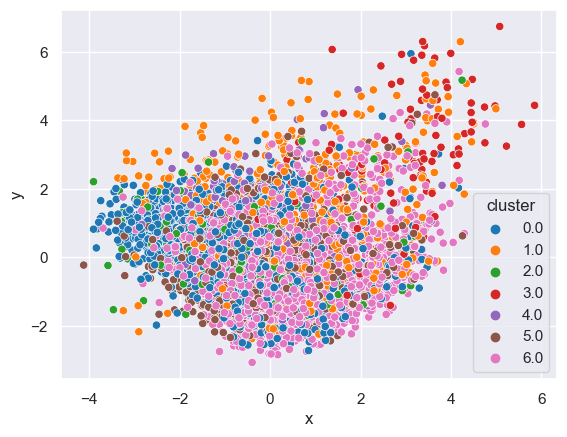

In [661]:
sns.scatterplot(data = projection_gm_pca, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

### Gridsearch GaussianMixture with UMAP

In [673]:
gs_gm_umap_df = rec_df.copy().select_dtypes(np.number)

In [674]:
gs_gm_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [675]:
gm_pipe_gs_umap = Pipeline(steps = [('scaler', StandardScaler()),
                                    ('umap', umap.UMAP()),
                                    ('model', GaussianMixture())])


In [679]:
gm_umap_grid = {'umap__n_neighbors':[2, 50, 100],
                    'umap__min_dist':[0.5, 0.8],
                    'model__n_components': [5, 7, 9, 13],
                    'model__max_iter':[100, 500, 1000],
                
                        }


In [680]:
gm_gs_umap = GridSearchCV(estimator= gm_pipe_gs_umap, 
                              param_grid = gm_umap_grid, 
                             cv=cv)

In [681]:
gm_gs_umap.fit(gs_gm_umap_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisation!

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\umap\spectral.py:260: UserWarning:

failed. This is likely due to too small an eigengap. Consider
adding some noise or jitter to your data.

Falling back to random initialisatio

GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('umap', UMAP()),
                                       ('model', GaussianMixture())]),
             param_grid={'model__max_iter': [100, 500, 1000],
                         'model__n_components': [5, 7, 9, 13],
                         'umap__min_dist': [0.5, 0.8],
                         'umap__n_neighbors': [2, 50, 100]})

In [682]:
gm_gs_umap.best_params_

{'model__max_iter': 1000,
 'model__n_components': 13,
 'umap__min_dist': 0.5,
 'umap__n_neighbors': 100}

In [683]:
gm_gs_umap.best_score_

-4.439613279358897

In [684]:
gm_gs_umap.scorer_

<function sklearn.metrics._scorer._passthrough_scorer(estimator, *args, **kwargs)>

In [685]:
preds_gm_umap = gm_gs_umap.predict(gs_gm_umap_df)

In [686]:
preds_gm_umap

array([ 6,  1,  8, ..., 11, 11, 12], dtype=int64)

In [687]:
gs_gm_umap_df['cluster'] = preds_gm_umap

In [688]:
gs_gm_umap_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,6
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,1
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,8
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,9
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,11
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,9
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,11
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,11


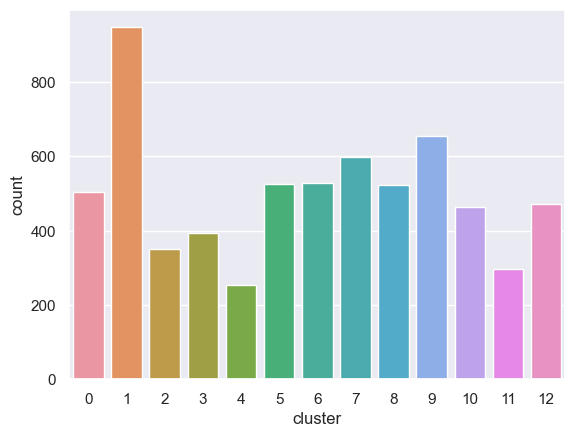

In [689]:
sns.countplot(data=gs_gm_umap_df, x = 'cluster');

In [690]:
gs_gm_umap_df['cluster'].value_counts()

1     948
9     654
7     598
6     528
5     526
8     524
0     505
12    471
10    464
3     394
2     350
11    298
4     253
Name: cluster, dtype: int64

In [691]:
gm_gs_umap_db = gm_gs_umap.best_estimator_.named_steps['umap'].transform(gs_gm_umap_df.drop('cluster', axis=1))

In [692]:
gm_gs_umap_df = pd.DataFrame(gm_gs_umap_db, columns=['umap_1', 'umap_2'])

In [693]:
gm_gs_umap_df.isna().sum()

umap_1    0
umap_2    0
dtype: int64

In [694]:
gm_gs_umap_df['cluster'] = gs_gm_umap_df['cluster']

In [695]:
gm_gs_umap_df

,umap_1,umap_2,cluster
0,6.354280,0.027899,6.0
1,6.370054,0.127456,1.0
2,6.473077,0.208142,8.0
3,6.496181,0.217049,9.0
4,6.407479,0.088677,8.0
...,...,...,...
6508,6.467917,0.084373,3.0
6509,6.337009,0.081227,11.0
6510,6.422027,0.183747,9.0
6511,6.343599,0.072007,11.0


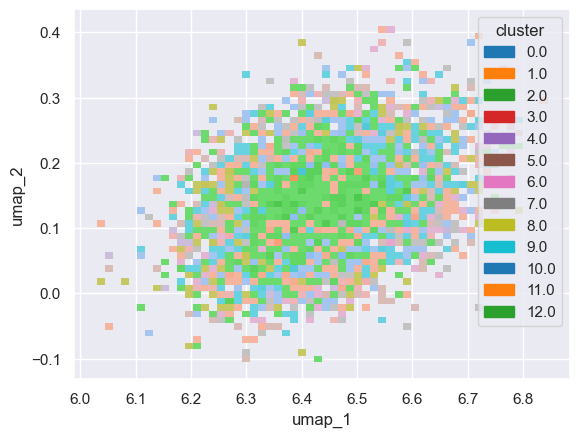

In [696]:
sns.histplot(x = 'umap_1', y = 'umap_2', data = gm_gs_umap_df, hue = 'cluster', palette = 'tab10');

In [697]:
px.scatter(gm_gs_umap_df, x = 'umap_1', y = 'umap_2', color = 'cluster', hover_data = ['umap_1', 'umap_2'])

In [716]:
clustering_metrics(gm_gs_umap_df.drop('cluster', axis=1), preds_gm_umap)

Silhouette Score:  -0.04130504 

 -------------------------- 


Calinski Harabasz Score:  1.3381966054259646  

 -------------------------- 


Davies Bouldin Score:  117.83234797583 

 -------------------------- 




### Gridsearch GaussianMixture with PCA

In [698]:
gs_gm_pca_df = rec_df.copy().select_dtypes(np.number)

In [699]:
gs_gm_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [700]:
gm_pipe_gs_pca = Pipeline(steps = [('scaler', StandardScaler()),
                                        ('pca', PCA()),
                                        ('model', GaussianMixture())])

In [701]:
gm_pca_grid = {'pca__n_components':[9, 11, 13, 'mle'],
                    'model__n_components': [5, 7, 9, 13],
                    'model__max_iter':[100, 500, 1000],
                  }


In [702]:
gm_gs_pca = GridSearchCV(estimator=gm_pipe_gs_pca,
                             param_grid = gm_pca_grid,
                             cv=cv)

In [703]:
gm_gs_pca.fit(gs_gm_pca_df)

GridSearchCV(cv=[(slice(None, None, None), slice(None, None, None))],
             estimator=Pipeline(steps=[('scaler', StandardScaler()),
                                       ('pca', PCA()),
                                       ('model', GaussianMixture())]),
             param_grid={'model__max_iter': [100, 500, 1000],
                         'model__n_components': [5, 7, 9, 13],
                         'pca__n_components': [9, 11, 13, 'mle']})

In [704]:
gm_pca_preds = gm_gs_pca.predict(gs_gm_pca_df)

In [705]:
gs_gm_pca_df['cluster'] = gm_pca_preds

In [706]:
gs_gm_pca_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature,cluster
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4,6
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4,1
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4,1
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4,3
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4,1
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4,1


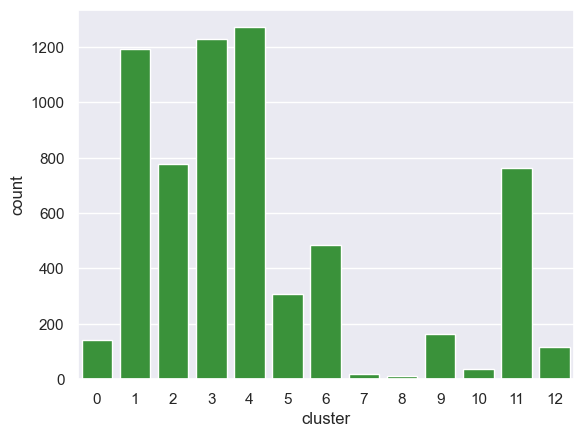

In [707]:
sns.countplot(data=gs_gm_pca_df, x = 'cluster', orient = "h", color = 'tab:green');

In [708]:
clustering_metrics(gs_gm_pca_df.drop('cluster', axis=1), gm_pca_preds)

Silhouette Score:  -0.19186764124172945 

 -------------------------- 


Calinski Harabasz Score:  79.02877766714688  

 -------------------------- 


Davies Bouldin Score:  68.35340613113193 

 -------------------------- 




In [709]:
gm_gs_pca.best_params_

{'model__max_iter': 100, 'model__n_components': 13, 'pca__n_components': 13}

In [710]:
gm_gs_pca.best_score_

-0.16129820792506536

In [711]:
gm_gs_pca.scorer_

<function sklearn.metrics._scorer._passthrough_scorer(estimator, *args, **kwargs)>

In [712]:
gm_pca_pipeline = Pipeline([('scaler', StandardScaler()), 
                            ('PCA', PCA(n_components=2))])

songs_gm_pca = gs_gm_pca_df 
song_embedding_gm_pca = gm_pca_pipeline.fit_transform(songs_gm_pca)
projection_gm_pca = pd.DataFrame(columns=['x', 'y'], data=song_embedding_gm_pca)

projection_gm_pca['artist'] = rec_df['artist']
projection_gm_pca['title'] = rec_df['track_name']
projection_gm_pca['cluster'] = gs_gm_pca_df['cluster']

In [713]:
projection_gm_pca

,x,y,artist,title,cluster
0,-0.387960,0.353154,Bon Jovi,Livin' On A Prayer,4.0
1,0.807613,2.163943,Bon Jovi,Wanted Dead Or Alive,6.0
2,-0.303910,-0.583133,Queen,We Are The Champions - Remastered 2011,1.0
3,-0.485844,-1.680785,Queen,We Will Rock You - Remastered 2011,4.0
4,-1.603979,0.260878,Bon Jovi,You Give Love A Bad Name,1.0
...,...,...,...,...,...
6508,-2.501983,-1.128190,Louis Armstrong,Blue Yodel No. 9 - 1996 Remastered,3.0
6509,-0.592509,-2.229548,N.W.A.,Gangsta Gangsta,1.0
6510,-2.820008,-0.415400,Various Artists,Rollin' With My Homies,3.0
6511,-3.111679,-0.423687,Nas,N.Y. State of Mind,1.0


In [714]:
plot_clusters(projection_gm_pca, 'x', 'y')

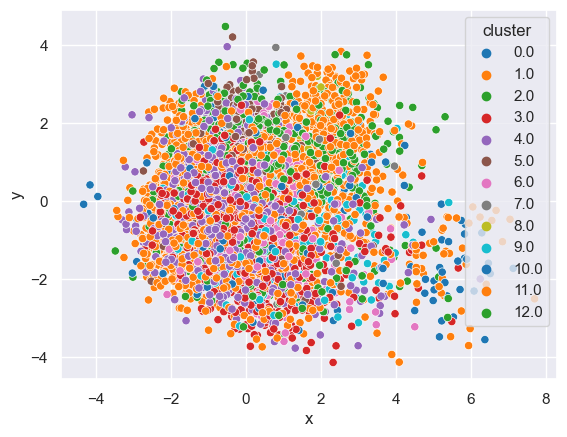

In [715]:
sns.scatterplot(data = projection_gm_pca, x = 'x', y='y', hue = 'cluster', palette = 'tab10');

## Final Model - MiniBatchKMeans with UMAP

In [718]:
final_model_pipe = Pipeline(steps = [('scaler', StandardScaler()),
                                     ('umap', umap.UMAP(min_dist = 0.8)),
                                     ('model', MiniBatchKMeans(batch_size = 1024,
                                                              max_iter = 100,
                                                              n_clusters=7))])

In [719]:
mbkmeans_base_song_df = rec_df.select_dtypes(np.number)
mbkmeans_base_song_df

,popularity,danceability,energy,key,loudness,mode,speechiness,instrumentalness,liveness,valence,tempo,duration_ms,time_signature
0,8,0.534,0.887,0,-3.777,1,0.0345,0.000099,0.3250,0.720,122.494,249293,4
1,0,0.257,0.819,7,-3.562,1,0.0422,0.015000,0.3240,0.267,150.354,308560,4
2,64,0.268,0.459,7,-6.948,0,0.0346,0.000000,0.1190,0.172,64.223,179200,4
3,69,0.693,0.497,2,-7.316,1,0.1190,0.000000,0.2580,0.473,81.308,122067,4
4,0,0.556,0.945,0,-4.347,0,0.0496,0.000004,0.3940,0.781,122.875,224307,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
6509,63,0.894,0.698,6,-8.264,0,0.2750,0.000004,0.3290,0.695,98.104,336917,4
6510,42,0.852,0.705,2,-10.981,1,0.0582,0.000002,0.1260,0.833,104.556,246040,4
6511,70,0.665,0.910,6,-4.682,0,0.2230,0.000000,0.2270,0.887,84.099,293973,4
6512,66,0.634,0.845,11,-5.058,0,0.3520,0.000005,0.0598,0.929,94.000,237027,4


In [720]:
final_model_pipe.fit(mbkmeans_base_song_df)

C:\Users\Jonathan\anaconda3\envs\recommendation-env\lib\site-packages\sklearn\cluster\_kmeans.py:1848: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 4096 or by setting the environment variable OMP_NUM_THREADS=4



Pipeline(steps=[('scaler', StandardScaler()),
                ('umap',
                 UMAP(min_dist=0.8, tqdm_kwds={'bar_format': '{desc}: {percentage:3.0f}%| {bar} {n_fmt}/{total_fmt} [{elapsed}]', 'desc': 'Epochs completed', 'disable': True})),
                ('model', MiniBatchKMeans(n_clusters=7))])

In [721]:
import pickle
import joblib

filename = 'finalized_model.pkl'
joblib.dump(final_model_pipe, filename)
pickle.dump(final_model_pipe, open(filename, 'wb'))

## Other stuff

In [ ]:
cluster_19 = projection.loc[projection['cluster'] == 19]

In [ ]:
cluster_19.columns

In [ ]:
def dist(row):
    x = row['x']
    y = row['y']
    distance=np.sqrt((xt-x)**2 + (yt-y)**2)
    return distance

xt = cluster_19.loc[cluster_19['title'] == "Don't Stop Me Now - Remastered 2011", 'x']
yt = cluster_19.loc[cluster_19['title'] == "Don't Stop Me Now - Remastered 2011", 'y']

cluster_19['distance'] = cluster_19.apply(dist, axis=1)

In [ ]:
cluster_19

In [ ]:
projection['distance'] = projection.apply(dist, axis=1)

In [ ]:
projection.sort_values('distance')[:10]

In [ ]:
xt = projection.loc[projection['title'] == "Livin' On A Prayer", 'x']
yt = projection.loc[projection['title'] == "Livin' On A Prayer", 'y']

projection['distance'] = projection.apply(dist, axis=1)
projection.sort_values('distance')[0:10]